# SmartAFNet

### - This algorithm uses the principles from REDNet (Refraction Error Detection Network) and applying it to work in a smartphone environment that utilizes visible light that comes from an eccentric light (camera flash)

### - This algorithm uses an activator called ReLU6

### - This algorithm does not use transfer learning from ResNet50 and REDNet

Installing neccessary libraries

In [ ]:
pip install tensorflow matplotlib numpy


Importing libraries needed for the model

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import tensorflow as tf
from tensorflow.keras import layers, models
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.preprocessing import image_dataset_from_directory
from tensorflow.keras.layers import Dense, GlobalAveragePooling2D
from tensorflow.keras.models import Model


Checking the correct tensorflow version

In [ ]:
print(f"TensorFlow version: {tf.__version__}")

TensorFlow version: 2.17.1


smartAFNet model creation with ReLU6 and transfer learning from ResNet50

In [ ]:
# Residual Block function with ReLU6 and filter adjustment
def residual_block(x, filters, kernel_size=3):
    """A residual block with two convolutional layers and a skip connection."""
    residual = x

    # First convolution layer
    x = layers.Conv2D(filters, kernel_size, padding='same', activation='relu')(x)

    # Second convolution layer
    x = layers.Conv2D(filters, kernel_size, padding='same')(x)

    # Residual (input) of number of filters used
    if residual.shape[-1] != filters:
        residual = layers.Conv2D(filters, (1, 1), padding='same')(residual)

    # Add the residual (skip connection) to the output
    x = layers.add([x, residual])
    x = layers.ReLU(max_value=6)(x)  # Use ReLU6
    return x

# Combined REDNet and ResNet model
def build_combined_model(input_shape, num_classes):
    # Load pretrained ResNet50 model, excluding the top layer
    base_model = ResNet50(weights='imagenet', include_top=False, input_shape=input_shape)

    # Freezing the base model layers to prevent them from being trained
    for layer in base_model.layers:
        layer.trainable = False

    # Passing the ResNet output through REDNet layers
    x = base_model.output

    # Initial Conv Layer from REDNet with ReLU6
    x = layers.Conv2D(32, (3, 3), padding='same', activation='relu')(x)
    x = layers.Conv2D(32, (3, 3), padding='same')(x)
    x = layers.ReLU(max_value=6)(x)  # ReLU6

    # Residual Block 1 with ReLU6
    x = residual_block(x, 64)
    x = layers.MaxPooling2D((2, 2))(x)

    # Residual Block 2 with ReLU6
    x = residual_block(x, 128)
    x = layers.MaxPooling2D((2, 2))(x)

    # Residual Block 3 with ReLU6
    x = residual_block(x, 256)

    # Use Global Average Pooling instead of another MaxPooling layer
    x = layers.GlobalAveragePooling2D()(x)

    # Fully Connected Layers with ReLU6
    x = layers.Dense(1024, activation='relu')(x)
    x = layers.ReLU(max_value=6)(x)  # ReLU6
    x = layers.Dropout(0.5)(x)
    x = layers.Dense(512, activation='relu')(x)
    x = layers.ReLU(max_value=6)(x)  # ReLU6
    x = layers.Dropout(0.5)(x)

    # Output layer
    outputs = layers.Dense(num_classes, activation='sigmoid')(x)

    # Define the combined model
    model = models.Model(inputs=base_model.input, outputs=outputs)

    return model


Loading the dataset, training and compiling the model.

In [ ]:
import os
import tensorflow as tf
from tensorflow.keras.preprocessing import image_dataset_from_directory

# Path to the uploaded dataset
dataset_dir = "/content"  # Root directory where all the class folders are

# Load the datasets using image_dataset_from_directory with validation_split
train_dataset = image_dataset_from_directory(
    dataset_dir,
    image_size=(224, 224),  # Resize images to 224x224
    batch_size=32,
    label_mode='categorical',  # Categorical labels (since it's a classification problem)
    shuffle=True,
    seed=123,  # Ensure reproducibility
    validation_split=0.15,  # 15% for validation
    subset="training"  # Use this as the training data
)

# Validation dataset (the remaining 15%)
val_dataset = image_dataset_from_directory(
    dataset_dir,
    image_size=(224, 224),
    batch_size=32,
    label_mode='categorical',
    shuffle=True,
    seed=123,
    validation_split=0.15,  #15% for validation
    subset="validation"  # Use this as the validation data
)

# Get the actual number of classes from the dataset
num_classes = len(train_dataset.class_names)
print(f"Number of classes detected: {num_classes}")
print(f"Class names: {train_dataset.class_names}")

# Verify the datasets
print(f"Training Dataset: {train_dataset}")
print(f"Validation Dataset: {val_dataset}")

# Define and compile the model
input_shape = (224, 224, 3)  # Input shape for ResNet50

# Use the detected num_classes in the model
model = build_combined_model(input_shape, num_classes)
model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])

# Display the model summary
model.summary()


for i, layer in enumerate(model.layers):
    layer_name = layer.name
    layer_output_shape = getattr(layer, 'output_shape', 'No output shape (e.g., InputLayer)')
    print(f"Layer {i}: {layer_name} ({layer_output_shape})")


# Train the model
history = model.fit(
    train_dataset,
    validation_data=val_dataset,
    epochs=10  # Adjust the number of epochs as needed
)


Found 480 files belonging to 4 classes.
Using 408 files for training.
Found 480 files belonging to 4 classes.
Using 72 files for validation.
Number of classes detected: 4
Class names: ['Astigmatism', 'Hyperopia', 'Myopia', 'Normal']
Training Dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 4), dtype=tf.float32, name=None))>
Validation Dataset: <_PrefetchDataset element_spec=(TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name=None), TensorSpec(shape=(None, 4), dtype=tf.float32, name=None))>
94765736/94765736 ━━━━━━━━━━━━━━━━━━━━ 7s 0us/step


Model: "functional"

┏━━━━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)              ┃ Output Shape           ┃        Param # ┃ Connected to           ┃
┡━━━━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━━━━━━┩
│ input_layer (InputLayer)  │ (None, 224, 224, 3)    │              0 │ -                      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_pad (ZeroPadding2D) │ (None, 230, 230, 3)    │              0 │ input_layer[0][0]      │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_conv (Conv2D)       │ (None, 112, 112, 64)   │          9,472 │ conv1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_bn                  │ (None, 112, 112, 64)   │            256 │ conv1_conv[0][0]       │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv1_relu (Activation)   │ (None, 112, 112, 64)   │              0 │ conv1_bn[0][0]         │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pad (ZeroPadding2D) │ (None, 114, 114, 64)   │              0 │ conv1_relu[0][0]       │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ pool1_pool (MaxPooling2D) │ (None, 56, 56, 64)     │              0 │ pool1_pad[0][0]        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_conv       │ (None, 56, 56, 64)     │          4,160 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_1_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_1_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_1_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_conv       │ (None, 56, 56, 64)     │         36,928 │ conv2_block1_1_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_bn         │ (None, 56, 56, 64)     │            256 │ conv2_block1_2_conv[0… │
│ (BatchNormalization)      │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_2_relu       │ (None, 56, 56, 64)     │              0 │ conv2_block1_2_bn[0][… │
│ (Activation)              │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_0_conv       │ (None, 56, 56, 256)    │         16,640 │ pool1_pool[0][0]       │
│ (Conv2D)                  │                        │                │                        │
├───────────────────────────┼────────────────────────┼────────────────┼────────────────────────┤
│ conv2_block1_3_conv       │ (None, 56, 56, 256)    │         16,640 │ conv2_block1_2_relu[0… │
│ (Conv2D)                  │                        │                │                        │
├──────────────────────

 Total params: 26,182,404 (99.88 MB)

 Trainable params: 2,594,692 (9.90 MB)

 Non-trainable params: 23,587,712 (89.98 MB)

Layer 0: input_layer (No output shape (e.g., InputLayer))
Layer 1: conv1_pad (No output shape (e.g., InputLayer))
Layer 2: conv1_conv (No output shape (e.g., InputLayer))
Layer 3: conv1_bn (No output shape (e.g., InputLayer))
Layer 4: conv1_relu (No output shape (e.g., InputLayer))
Layer 5: pool1_pad (No output shape (e.g., InputLayer))
Layer 6: pool1_pool (No output shape (e.g., InputLayer))
Layer 7: conv2_block1_1_conv (No output shape (e.g., InputLayer))
Layer 8: conv2_block1_1_bn (No output shape (e.g., InputLayer))
Layer 9: conv2_block1_1_relu (No output shape (e.g., InputLayer))
Layer 10: conv2_block1_2_conv (No output shape (e.g., InputLayer))
Layer 11: conv2_block1_2_bn (No output shape (e.g., InputLayer))
Layer 12: conv2_block1_2_relu (No output shape (e.g., InputLayer))
Layer 13: conv2_block1_0_conv (No output shape (e.g., InputLayer))
Layer 14: conv2_block1_3_conv (No output shape (e.g., InputLayer))
Layer 15: conv2_block1_0_bn (No output shape (e.g., InputLayer))
Layer 16: 

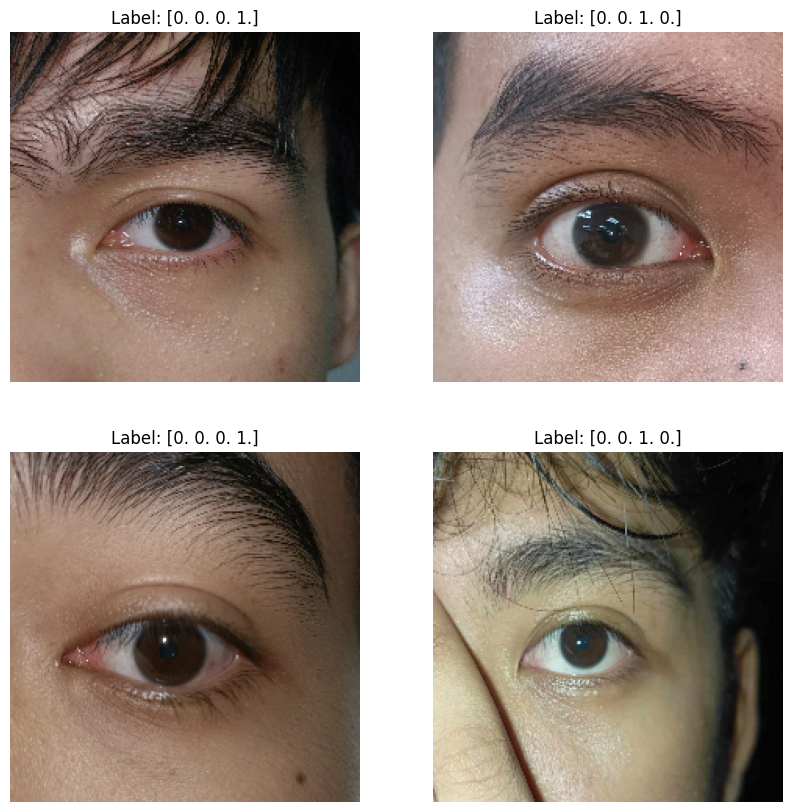

In [ ]:
# Display a few images from the dataset to verify
import matplotlib.pyplot as plt

# Take one batch from the train dataset
images, labels = next(iter(train_dataset))

# Plot the first 4 images in the batch
plt.figure(figsize=(10, 10))
for i in range(4):
    ax = plt.subplot(2, 2, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(f"Label: {labels[i].numpy()}")
    plt.axis("off")
plt.show()


Evaluating the model using the validation set

In [ ]:
# Evaluate the model on the validation dataset
val_loss, val_accuracy = model.evaluate(val_dataset)

# Print the evaluation results
print(f"Validation Loss: {val_loss}")
print(f"Validation Accuracy: {val_accuracy}")


3/3 ━━━━━━━━━━━━━━━━━━━━ 15s 4s/step - accuracy: 0.7018 - loss: 0.8066
Validation Loss: 0.8237401247024536
Validation Accuracy: 0.7083333134651184


Saving the model

In [ ]:
# Save the trained model in Keras format
model.save('my_model.h5')


TESTING ON UNKNOWN IMAGES TO CHECK FOR ACCURACY

1/1 ━━━━━━━━━━━━━━━━━━━━ 2s 2s/step


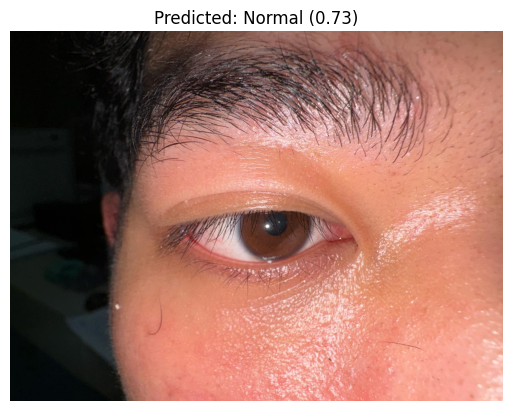

Image: /content/Myopia/att.u0Xv_LaA-q-VcJUD6x6rEblflTUyXmXr-AUpqhRYOSg.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


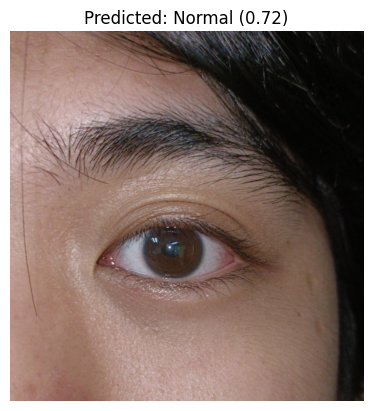

Image: /content/Myopia/IMG_20241124_144739.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 192ms/step


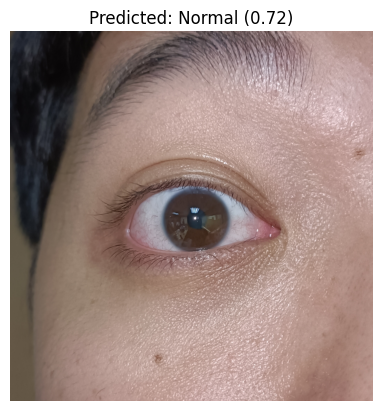

Image: /content/Myopia/IMG_20241124_145102.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step


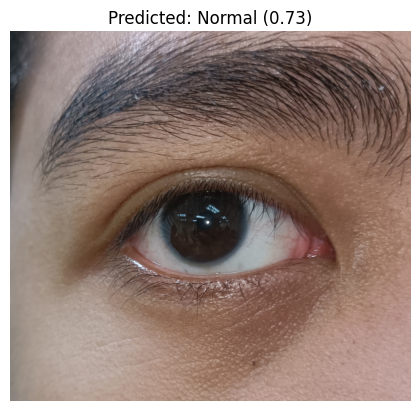

Image: /content/Myopia/IMG_20241128_170411.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 203ms/step


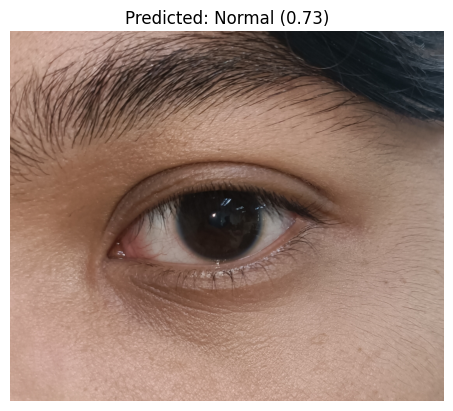

Image: /content/Myopia/IMG_20241128_170004.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 220ms/step


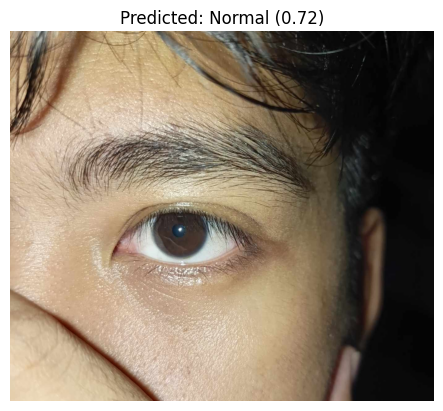

Image: /content/Myopia/IMG_20241117_231739.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 197ms/step


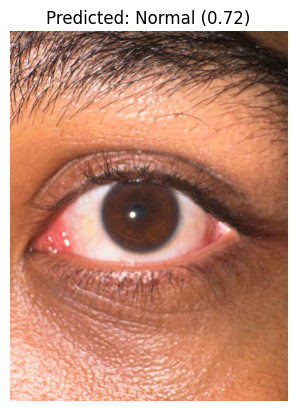

Image: /content/Myopia/att.CwLPS8fNxY7Miu-I-ea_kneKR_385yEZGZ7MSbo6LZI.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 217ms/step


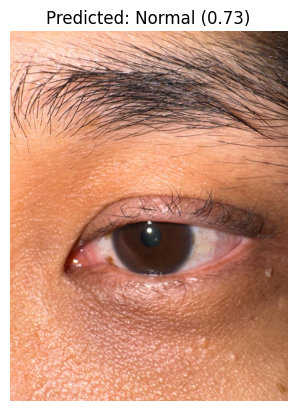

Image: /content/Myopia/att.uNmz_myJAhFBW3jM0ipok7-1O59Xadvsj7RLU5M3Mpk.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 206ms/step


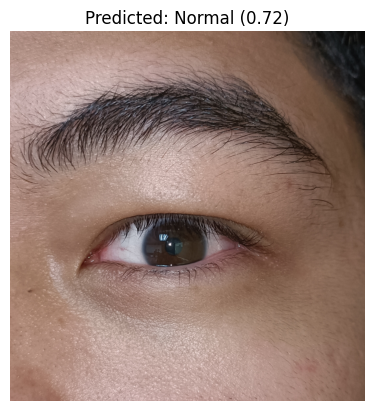

Image: /content/Myopia/IMG_20241124_145751.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 228ms/step


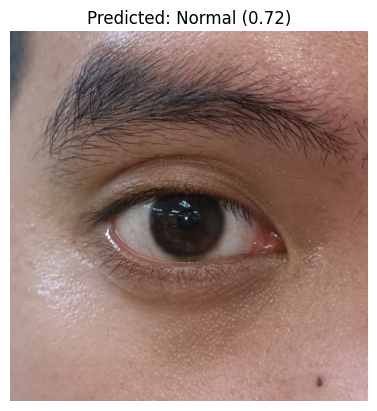

Image: /content/Myopia/IMG_20241128_170452.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step


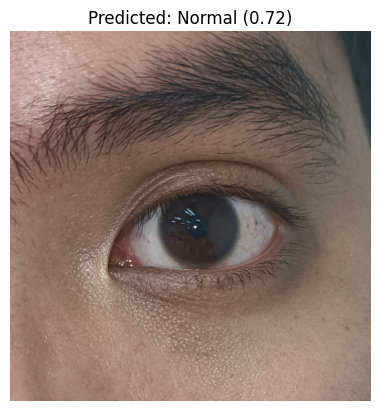

Image: /content/Myopia/IMG_20241128_171720.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 337ms/step


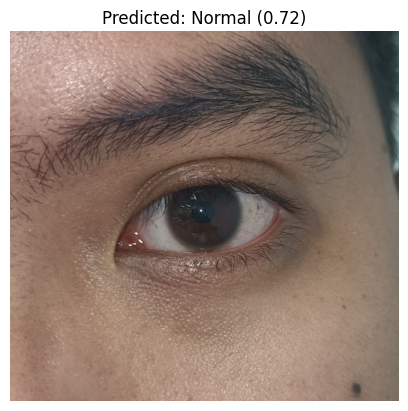

Image: /content/Myopia/IMG_20241128_170137.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 347ms/step


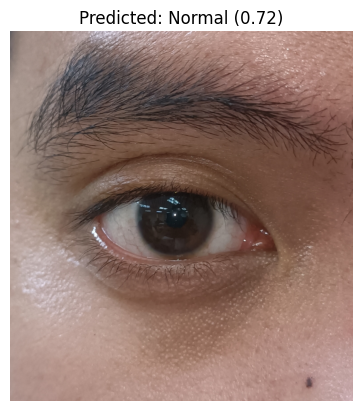

Image: /content/Myopia/IMG_20241128_170503.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 341ms/step


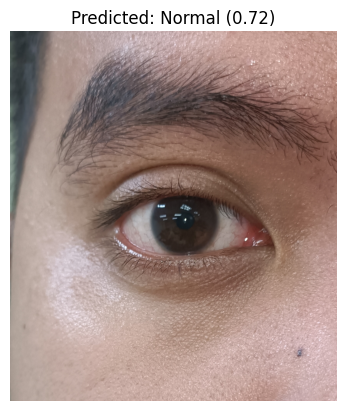

Image: /content/Myopia/IMG_20241128_172307.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 335ms/step


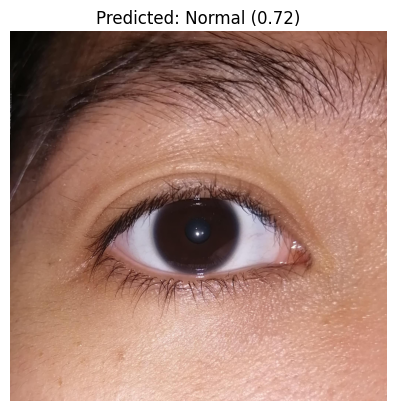

Image: /content/Myopia/d9543aee-8d4a-4aaf-97c7-9379808d82cf.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 234ms/step


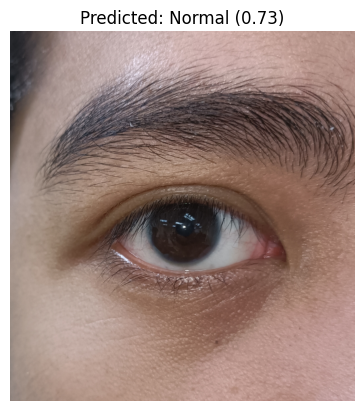

Image: /content/Myopia/IMG_20241128_170326.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 246ms/step


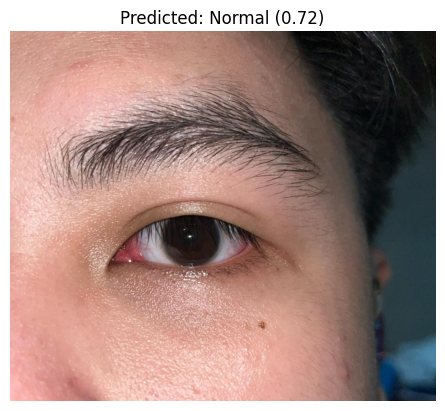

Image: /content/Myopia/IMG_20241117_231751.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 221ms/step


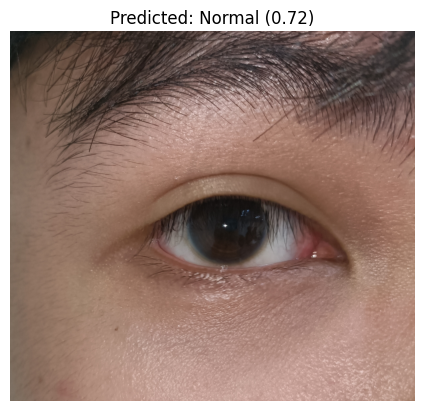

Image: /content/Myopia/IMG_20241128_165710.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 300ms/step


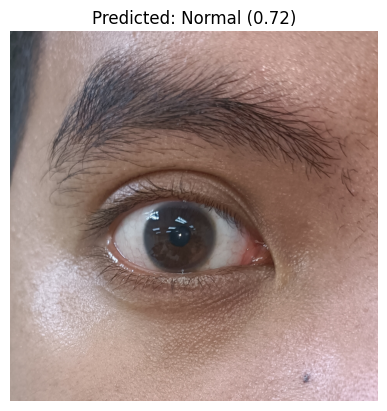

Image: /content/Myopia/IMG_20241128_172444.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 227ms/step


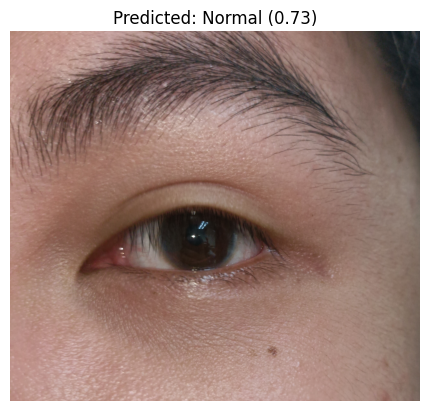

Image: /content/Myopia/IMG_20241128_165740.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 232ms/step


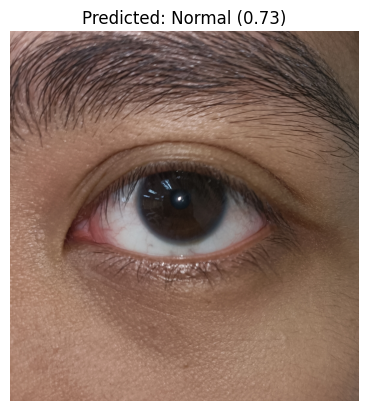

Image: /content/Myopia/IMG_20241128_170209.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 256ms/step


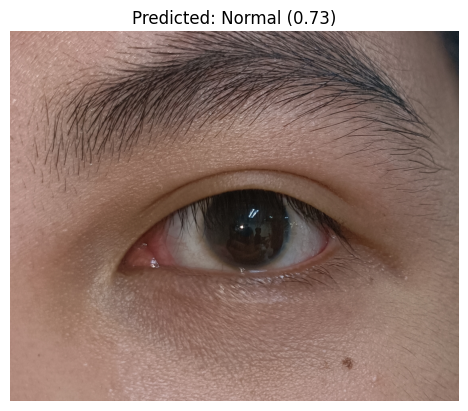

Image: /content/Myopia/IMG_20241128_165818.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


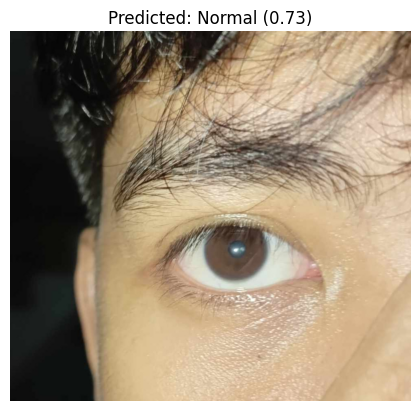

Image: /content/Myopia/IMG_20241117_231659.jpg
Predicted Class: Normal
Confidence: 0.73
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 245ms/step


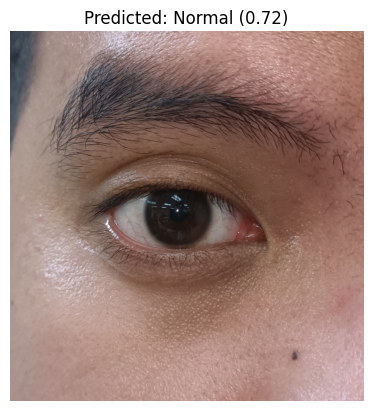

Image: /content/Myopia/IMG_20241128_170434.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 266ms/step


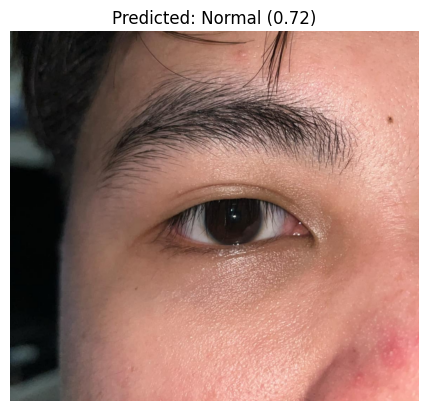

Image: /content/Myopia/IMG_20241117_231815.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step


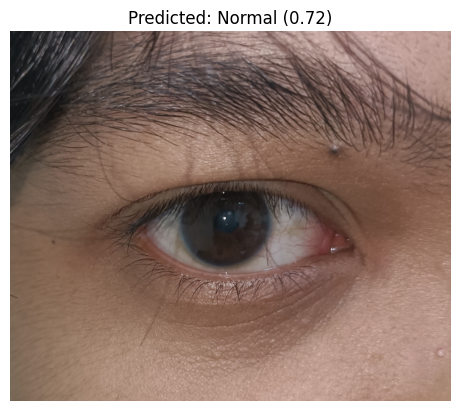

Image: /content/Myopia/IMG_20241128_165922.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 297ms/step


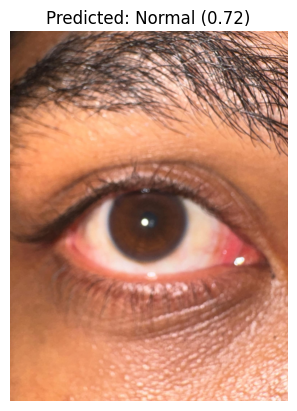

Image: /content/Myopia/att.GB3_Dtvo-NFh6rxygLsNuDyAZBI3KVQbuTpfa-kYFLg.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 385ms/step


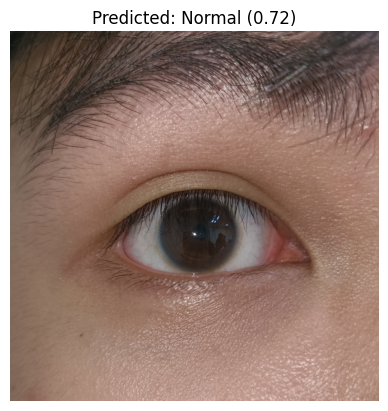

Image: /content/Myopia/IMG_20241128_165652.jpg
Predicted Class: Normal
Confidence: 0.72
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 402ms/step


KeyboardInterrupt: 

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from tensorflow.keras.models import load_model
from tensorflow.keras.preprocessing.image import load_img, img_to_array
from tensorflow.keras.preprocessing import image_dataset_from_directory


# Define the class names (these should match the class names used during training)
class_names = ['Hyperopia', 'Myopia', 'Astigmatism', 'Normal', 'Presbyopia']

# Path to the trained model
model_path = "/content/my_model.h5"  # Replace with your saved model's path
# Save the trained model for future use (if not already saved)

# Load the trained model
model = load_model(model_path)

# Path to the directory containing unknown images
unknown_images_dir = "/content/Myopia"

# Function to preprocess a single image
def preprocess_image(image_path, target_size=(224, 224)):
    """
    Preprocesses an image for model prediction.
    - Resizes the image to the target size.
    - Normalizes pixel values to [0, 1].
    - Expands dimensions to make it batch-compatible.
    """
    img = load_img(image_path, target_size=target_size)  # Load and resize the image
    img_array = img_to_array(img)  # Convert the image to a NumPy array
    img_array = img_array / 255.0  # Normalize pixel values
    img_array = np.expand_dims(img_array, axis=0)  # Add batch dimension
    return img_array

# Function to predict class for an image
def predict_image_class(image_path, model, class_names):
    """
    Predicts the class of a given image using the provided model.
    Returns the predicted class and confidence score.
    """
    # Preprocess the image
    preprocessed_image = preprocess_image(image_path)

    # Predict the class probabilities
    prediction = model.predict(preprocessed_image)

    # Decode the predicted class
    predicted_class = class_names[np.argmax(prediction)]
    confidence_score = np.max(prediction)  # Confidence score for the prediction

    return predicted_class, confidence_score

# List all image files in the unknown images directory
image_paths = [os.path.join(unknown_images_dir, fname) for fname in os.listdir(unknown_images_dir) if fname.lower().endswith(('png', 'jpg', 'jpeg'))]

# Predict and display results for each image
for img_path in image_paths:
    # Get the predicted class and confidence score
    predicted_class, confidence_score = predict_image_class(img_path, model, class_names)

    # Display the image and its prediction
    img = load_img(img_path)  # Load the image for visualization
    plt.imshow(img)
    plt.title(f"Predicted: {predicted_class} ({confidence_score:.2f})")
    plt.axis('off')
    plt.show()

    # Print the prediction details in the console
    print(f"Image: {img_path}")
    print(f"Predicted Class: {predicted_class}")
    print(f"Confidence: {confidence_score:.2f}")

# Evaluate the model accuracy on the unknown dataset if ground truth is available
# Assuming a directory structure in /content/new (each subfolder is a class name)
if os.path.isdir(unknown_images_dir):
    test_dataset = image_dataset_from_directory(
        unknown_images_dir,
        image_size=(224, 224),
        batch_size=32,
        label_mode='categorical',  # Assuming labels exist
        shuffle=False
    )

    # Evaluate the model on the test dataset
    test_loss, test_accuracy = model.evaluate(test_dataset)

    # Print the evaluation results
    print(f"Test Loss: {test_loss}")
    print(f"Test Accuracy: {test_accuracy}")


Converting the model to fit in the iTest Mobile Application in Android Studio

In [ ]:
import tensorflow as tf

# Convert the Keras model to TensorFlow Lite format
converter = tf.lite.TFLiteConverter.from_keras_model(model)  # Use the trained model directly
tflite_model = converter.convert()

# Save the TFLite model to a file
tflite_model_path = 'model.tflite'
with open(tflite_model_path, 'wb') as f:
    f.write(tflite_model)

print(f"Model saved to {tflite_model_path}")


Saved artifact at '/tmp/tmpt2q4h2js'. The following endpoints are available:

* Endpoint 'serve'
  args_0 (POSITIONAL_ONLY): TensorSpec(shape=(None, 224, 224, 3), dtype=tf.float32, name='keras_tensor_1649')
Output Type:
  TensorSpec(shape=(None, 5), dtype=tf.float32, name=None)
Captures:
  133106971077344: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106971069424: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106971069952: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106971079808: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106971080512: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106969465024: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106970899408: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106970893072: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106971019568: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133106971020272: TensorSpec(shape=(), dtype=tf.resource, name=None)
  133107701

**Generate Grad-CAM**
- To be used for classification and validation

**Grad-CAM first iteration on base dataset**

14536120/14536120 ━━━━━━━━━━━━━━━━━━━━ 0s 0us/step


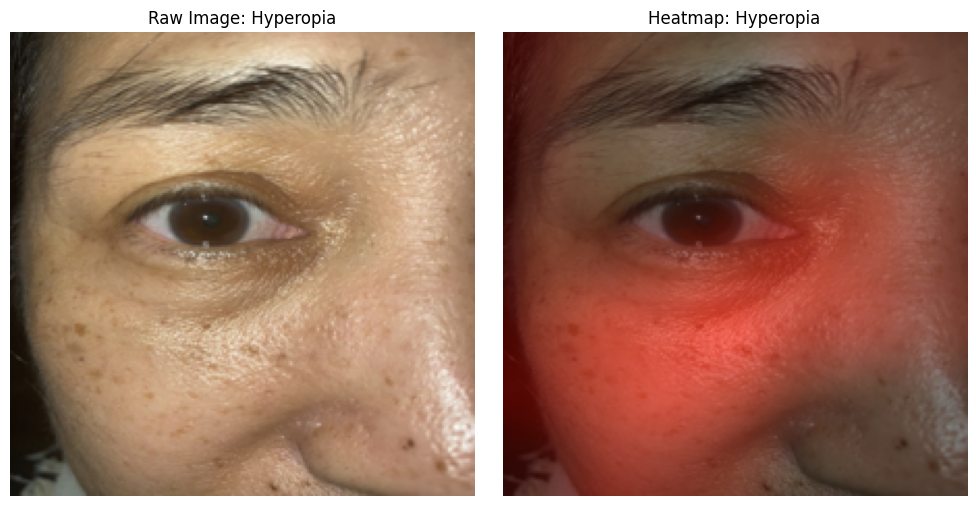

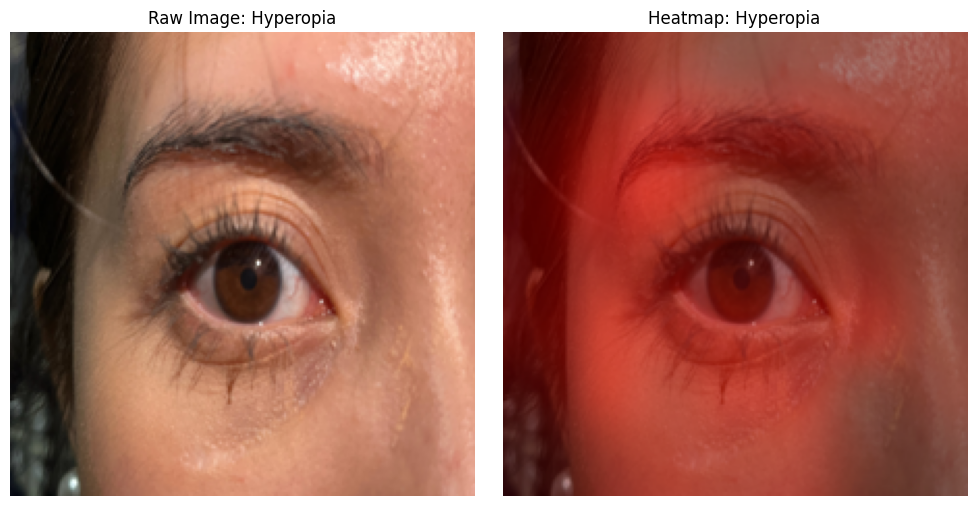

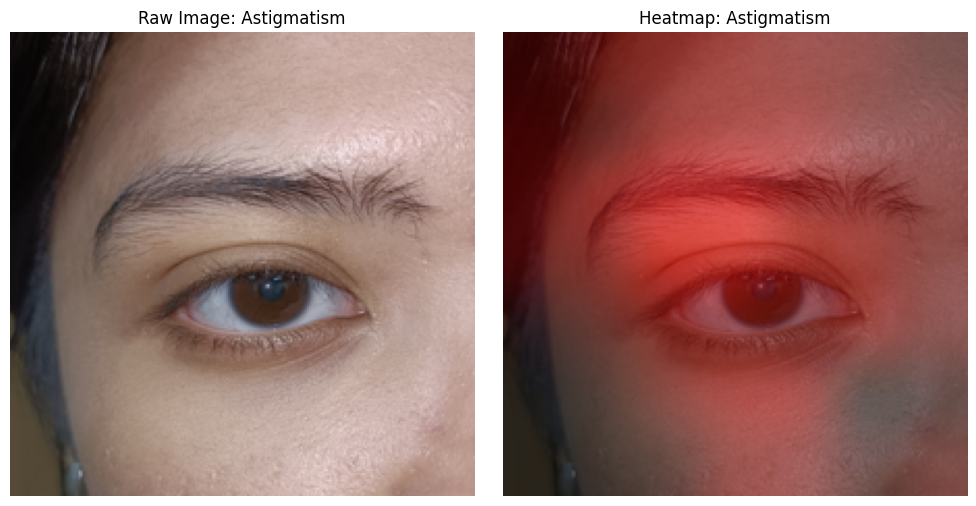

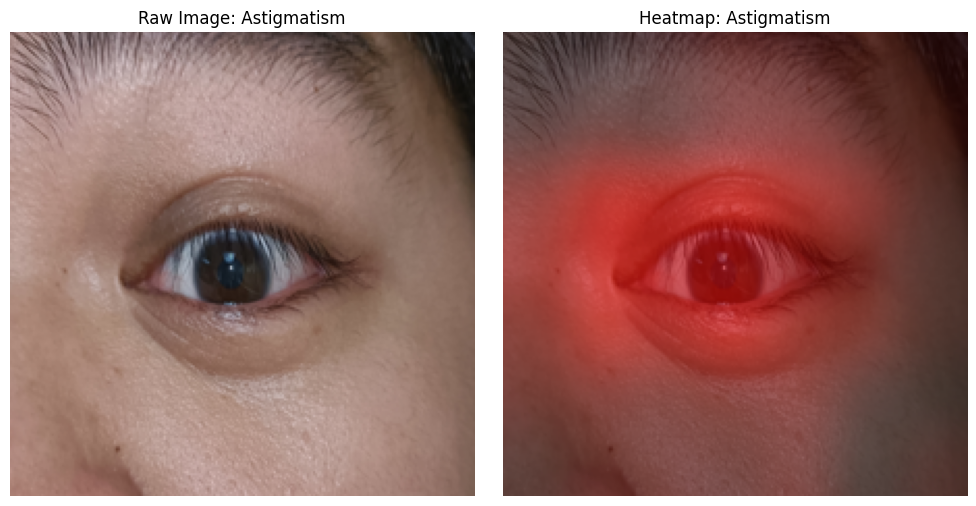

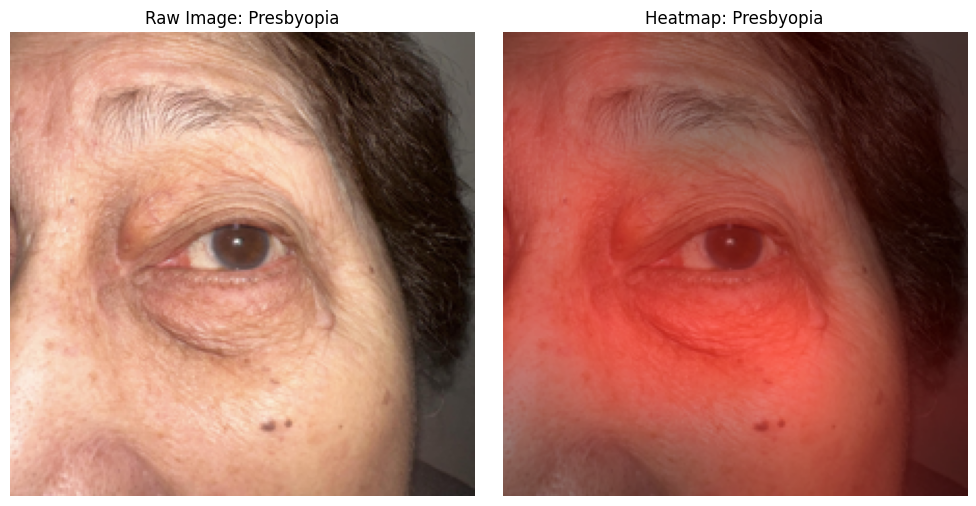

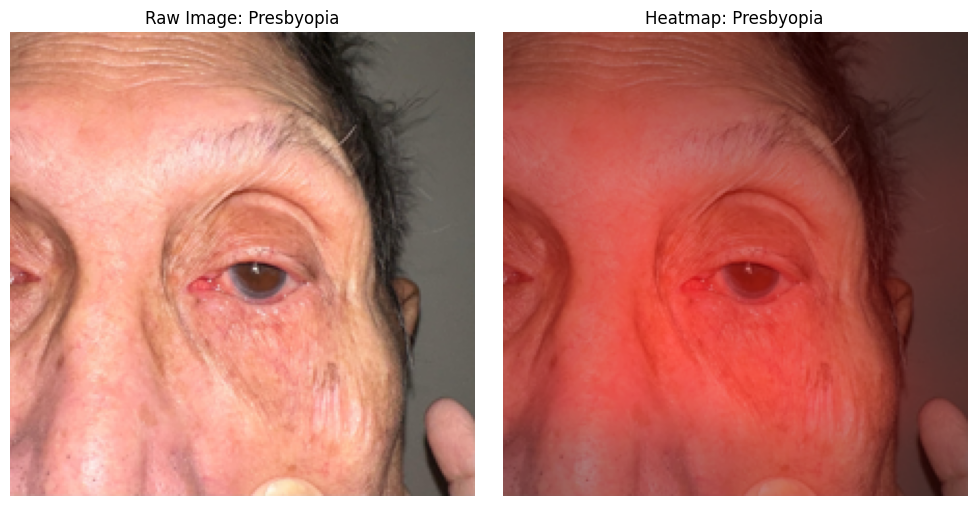

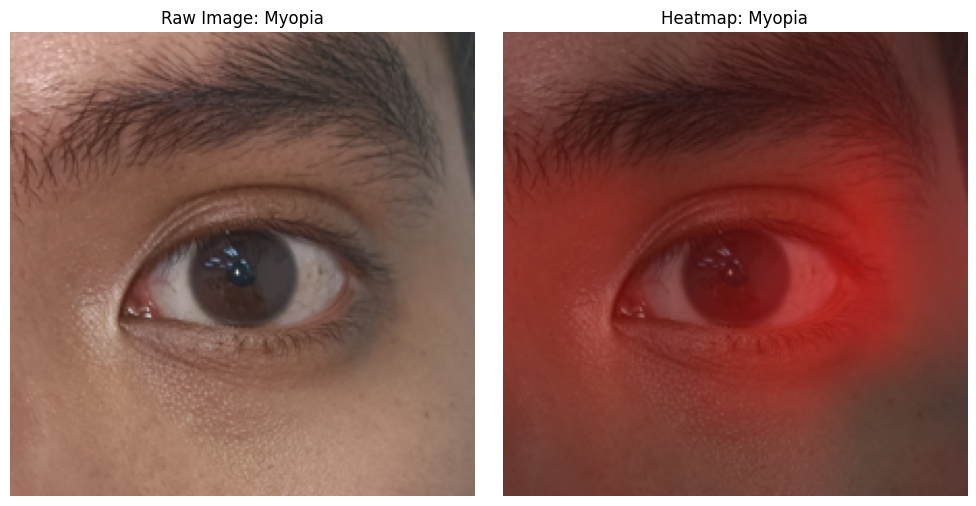

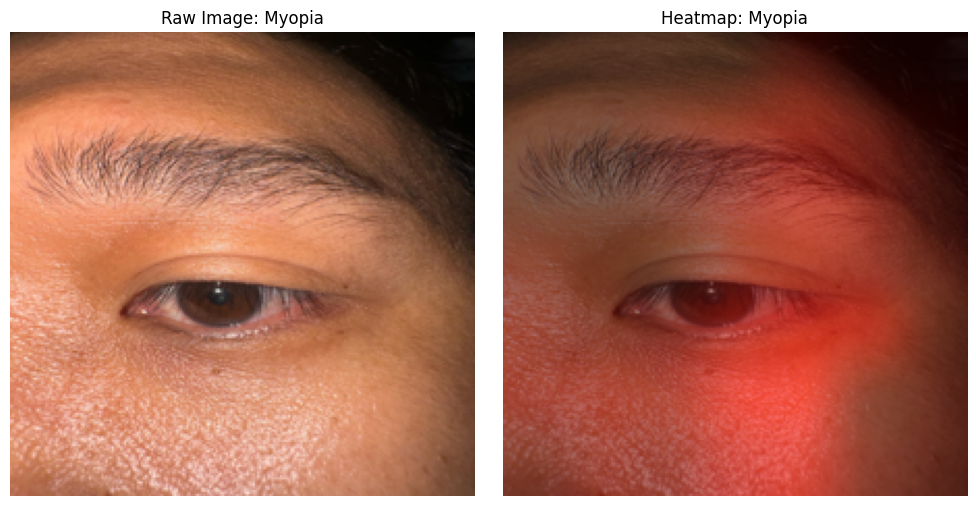

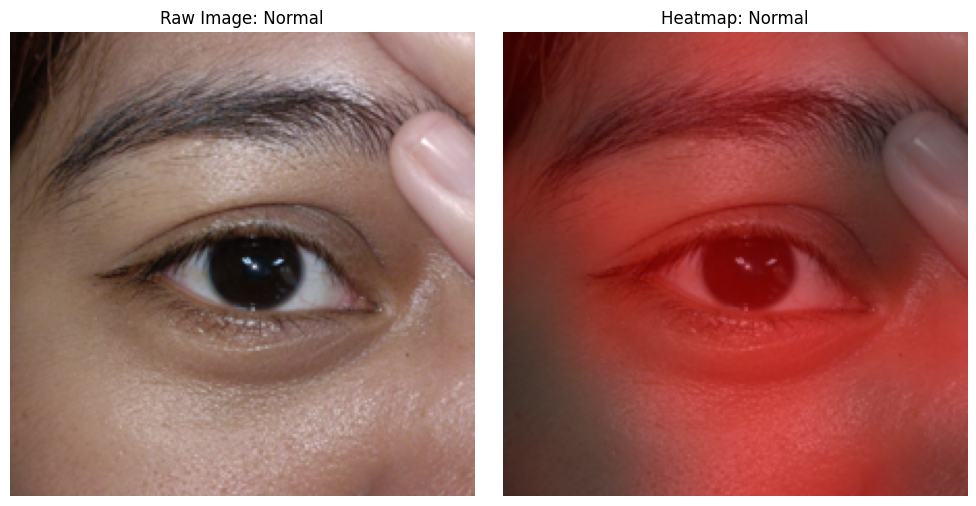

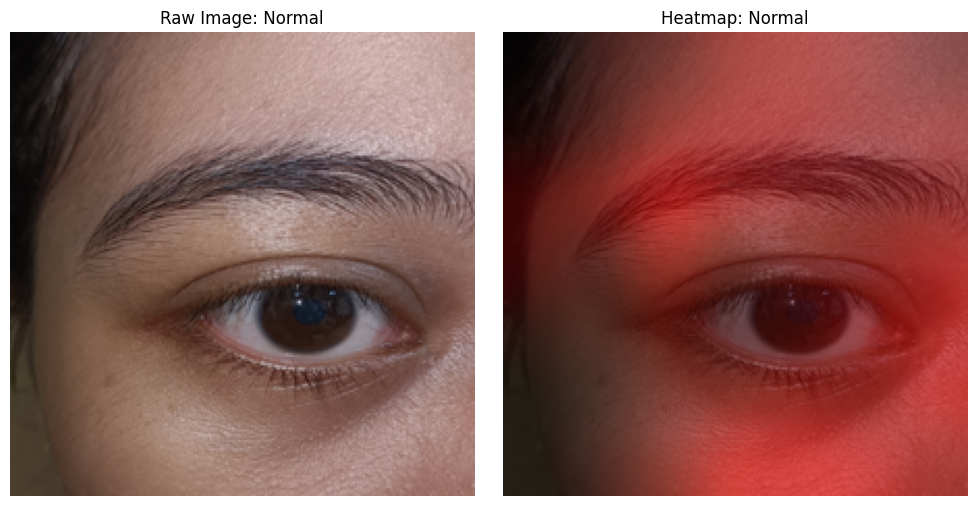

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.preprocessing import image

# Load a pretrained model (e.g., MobileNetV2)
model = MobileNetV2(weights="imagenet")
last_conv_layer_name = "Conv_1"  # Last convolutional layer for Grad-CAM

#def load_model():
		#base_model = smartAFNet
		#base_model.trainable = false
		#model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
		#return model

# Function to preprocess the image for the model
def preprocess_image(img_path):
    img = image.load_img(img_path, target_size=(224, 224))
    img_array = image.img_to_array(img)
    img_array = np.expand_dims(img_array, axis=0)
    return preprocess_input(img_array)

# Function to generate Grad-CAM heatmap
def get_grad_cam_heatmap(model, img_array, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# Function to overlay the heatmap on the image
def overlay_heatmap_on_image(img_path, heatmap, alpha=0.5):
    img = Image.open(img_path).resize((224, 224))
    heatmap = Image.fromarray(np.uint8(255 * heatmap)).resize(img.size, Image.BICUBIC)
    heatmap = np.array(heatmap)
    heatmap = np.stack([heatmap, np.zeros_like(heatmap), np.zeros_like(heatmap)], axis=-1)
    overlay = np.clip((1 - alpha) * np.array(img) + alpha * heatmap, 0, 255).astype("uint8")
    return Image.fromarray(overlay)

# Function to display raw image and heatmap
def display_images(img_path, heatmap, label):
    raw_image = Image.open(img_path).resize((224, 224))
    heatmapped_image = overlay_heatmap_on_image(img_path, heatmap)

    # Display the images side by side
    fig, axs = plt.subplots(1, 2, figsize=(10, 5))
    axs[0].imshow(raw_image)
    axs[0].set_title(f"Raw Image: {label}")
    axs[0].axis("off")
    axs[1].imshow(heatmapped_image)
    axs[1].set_title(f"Heatmap: {label}")
    axs[1].axis("off")
    plt.tight_layout()
    plt.show()

# Base directory where the datasets are stored
base_dir = "/content/"
for label in os.listdir(base_dir):
    folder_path = os.path.join(base_dir, label)
    if not os.path.isdir(folder_path):
        continue  # Skip non-directory files

    # List all image files in the folder
    images = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]

    # Process and display two images per folder
    for img_path in images[:2]:  # Display only the first 2 images per folder
        img_array = preprocess_image(img_path)
        heatmap = get_grad_cam_heatmap(model, img_array, last_conv_layer_name)
        display_images(img_path, heatmap, label)


**Grad-CAM second iteration on base dataset**

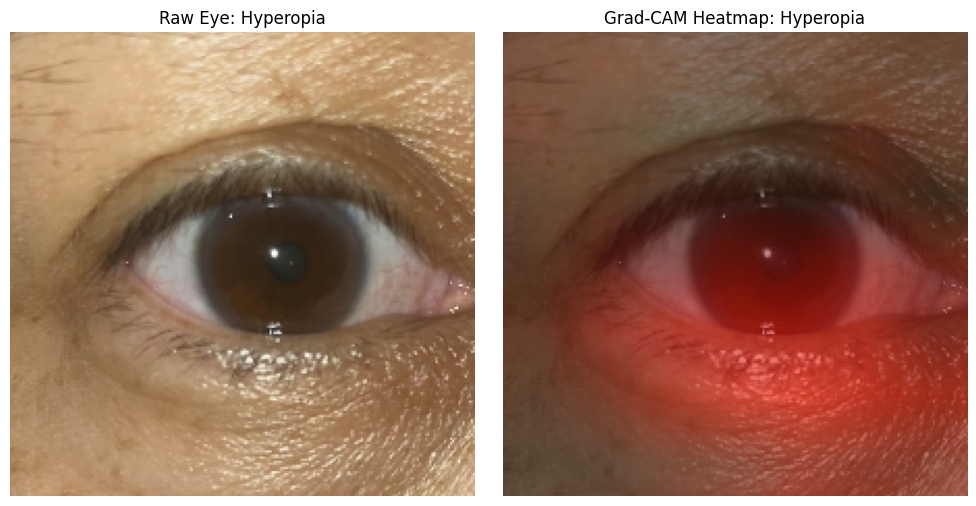

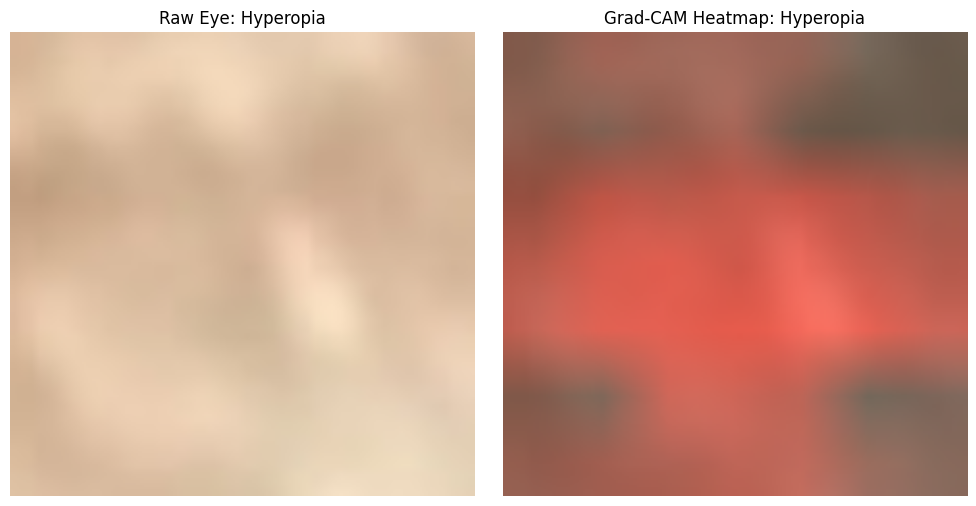

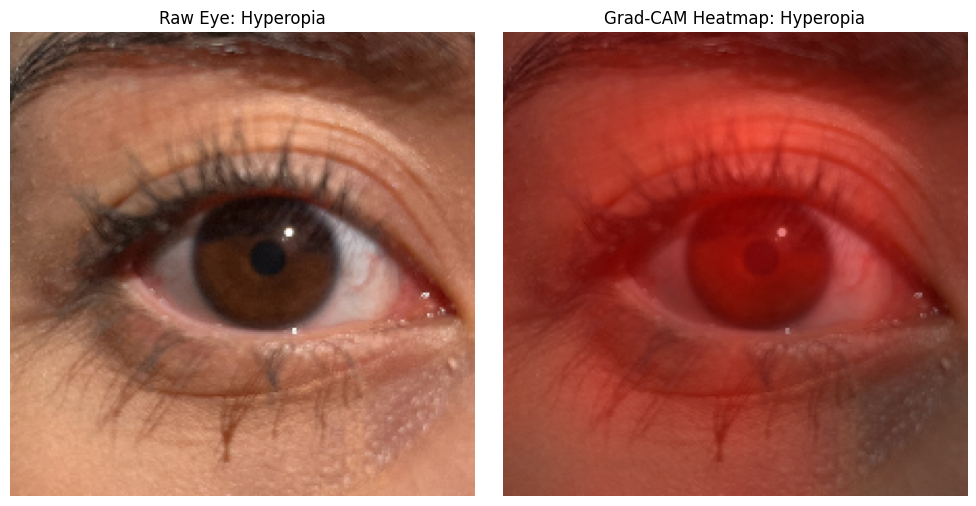

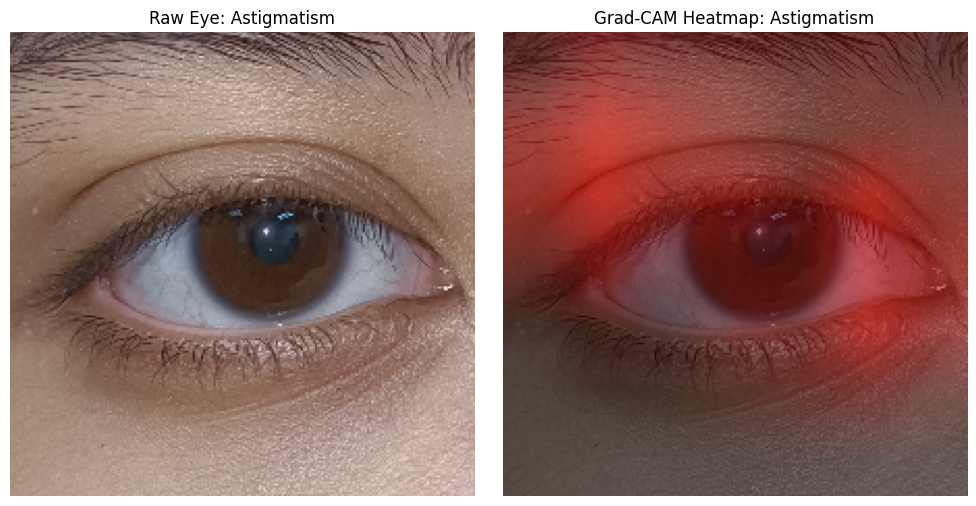

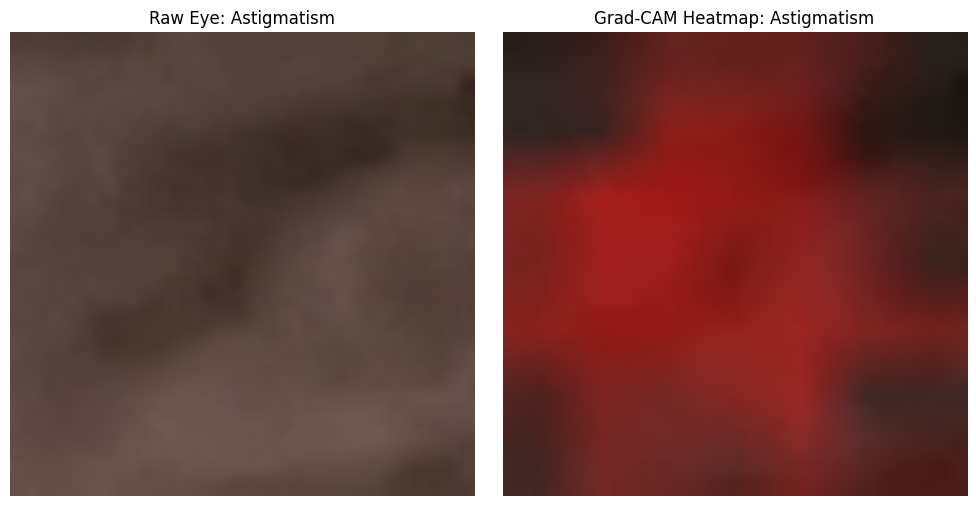

...

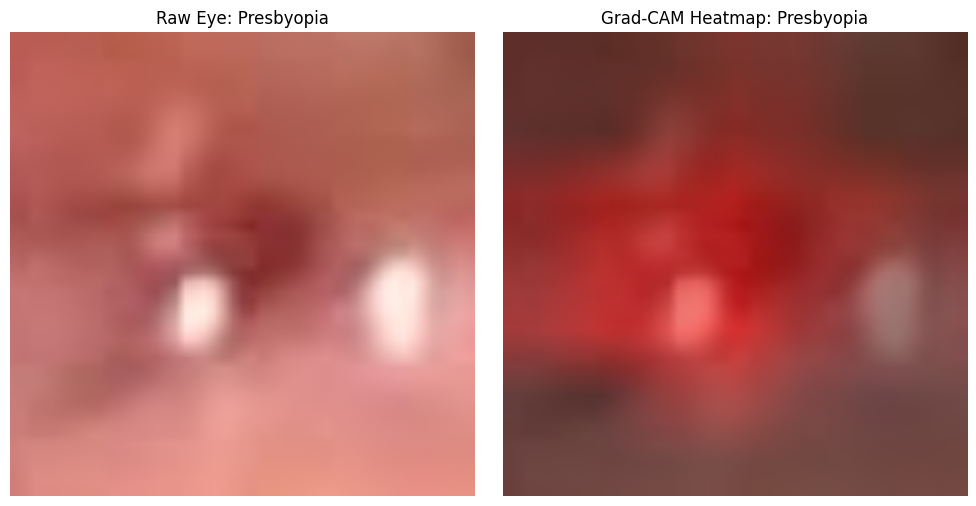

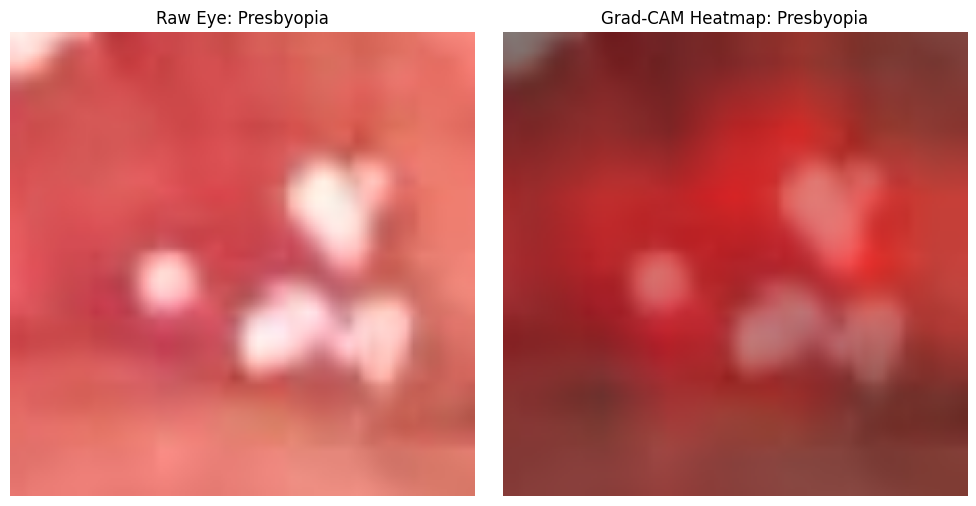

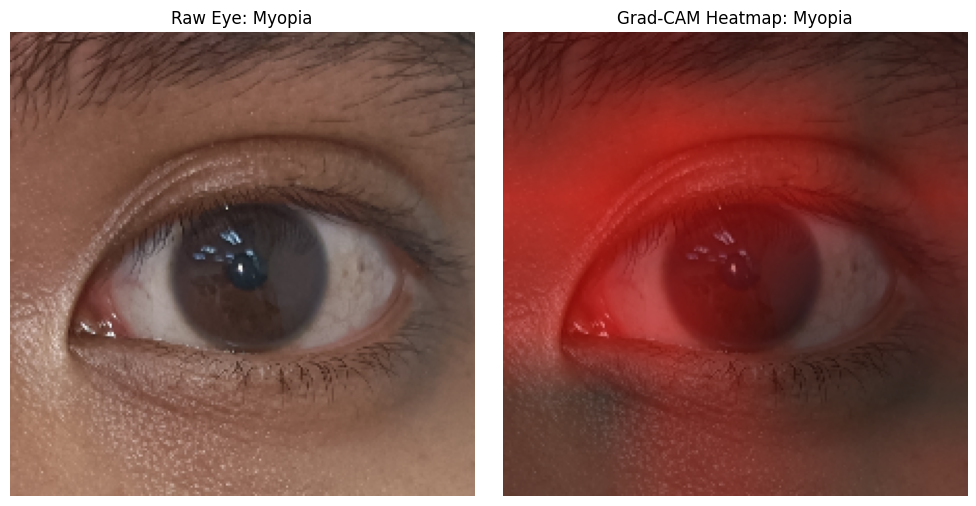

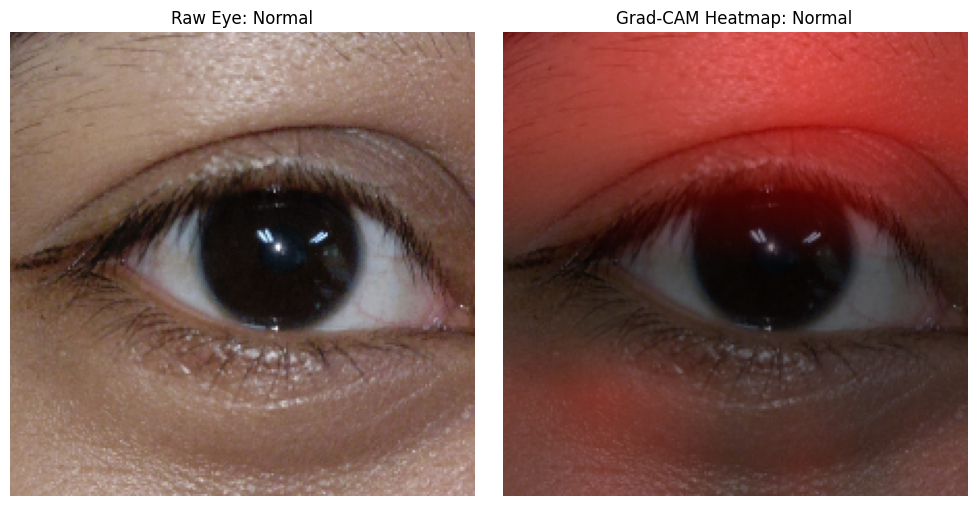

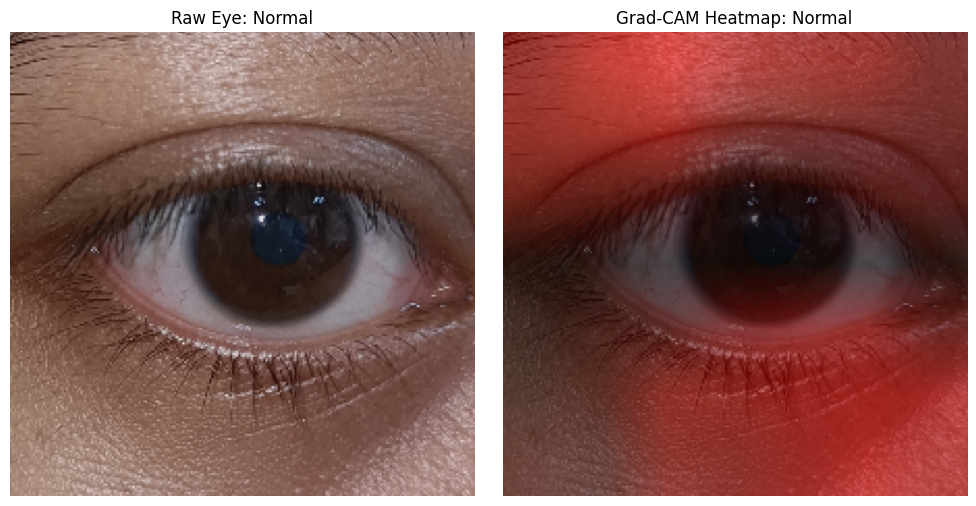

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input

# Load a pretrained model (MobileNetV2)
model = MobileNetV2(weights="imagenet")
last_conv_layer_name = "Conv_1"

#def load_model():
		#base_model = smartAFNet
		#base_model.trainable = false
		#model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
		#return model

# Haar Cascade for eye detection
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')

# Function to detect and crop eye region
def detect_eyes(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    eyes = eye_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=10, minSize=(30, 30))

    cropped_eyes = []
    for (x, y, w, h) in eyes:
        cropped = img[y:y+h, x:x+w]
        cropped_eyes.append(cv2.resize(cropped, (224, 224)))
    return cropped_eyes

# Grad-CAM heatmap function
def get_grad_cam_heatmap(model, img_array, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# Overlay heatmap on image
def overlay_heatmap(image, heatmap, alpha=0.5):
    heatmap = np.uint8(255 * heatmap)
    heatmap = cv2.resize(heatmap, (image.size[0], image.size[1]))
    heatmap = np.stack([heatmap, np.zeros_like(heatmap), np.zeros_like(heatmap)], axis=-1)
    overlay = np.clip((1 - alpha) * np.array(image) + alpha * heatmap, 0, 255).astype("uint8")
    return Image.fromarray(overlay)

# Function to preprocess and display Grad-CAM
def process_and_display(image_path, label):
    eyes = detect_eyes(image_path)
    for eye in eyes[:2]:  # Limit to 2 eyes per image
        img_array = preprocess_input(np.expand_dims(eye, axis=0))  # Preprocess for model
        heatmap = get_grad_cam_heatmap(model, img_array, last_conv_layer_name)

        # Convert eye region to PIL image
        raw_eye_image = Image.fromarray(cv2.cvtColor(eye, cv2.COLOR_BGR2RGB))
        heatmapped_image = overlay_heatmap(raw_eye_image, heatmap)

        # Display raw and heatmapped images
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        axs[0].imshow(raw_eye_image)
        axs[0].set_title(f"Raw Eye: {label}")
        axs[0].axis("off")
        axs[1].imshow(heatmapped_image)
        axs[1].set_title(f"Grad-CAM Heatmap: {label}")
        axs[1].axis("off")
        plt.tight_layout()
        plt.show()

# Directory containing datasets
base_dir = "/content/"
for label in os.listdir(base_dir):
    folder_path = os.path.join(base_dir, label)
    if not os.path.isdir(folder_path):
        continue

    # Iterate through the first 2 images in the folder
    images = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
    for img_path in images[:2]:
        process_and_display(img_path, label)


**Grad-CAM testing on base dataset for monitoring of classification**

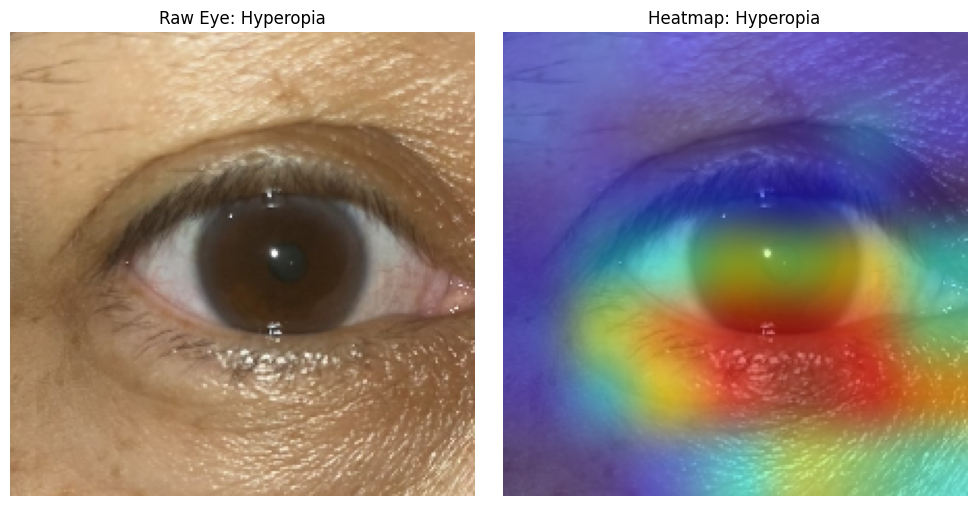

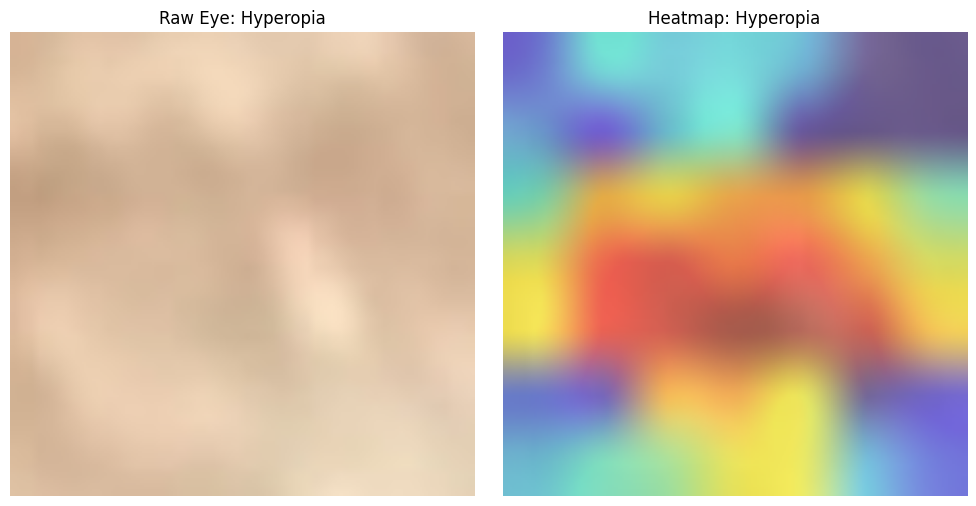

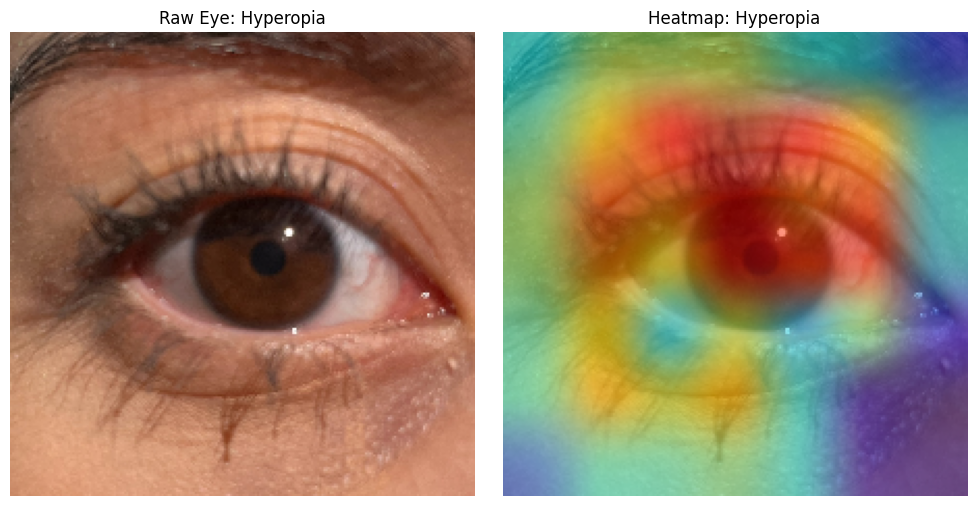

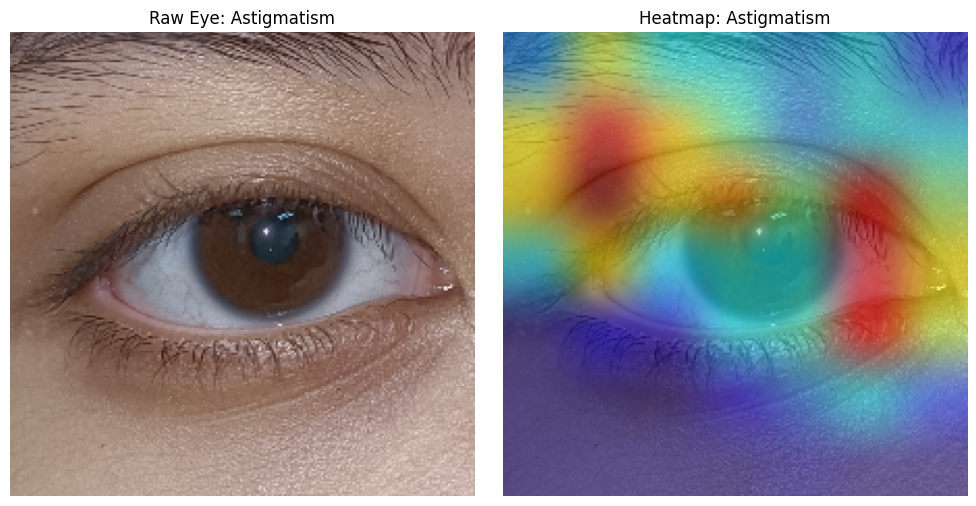

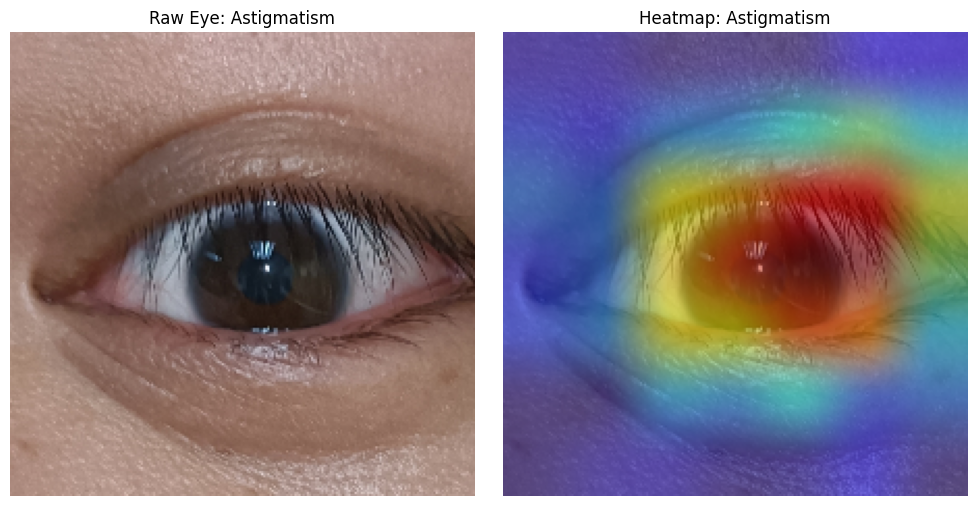

...

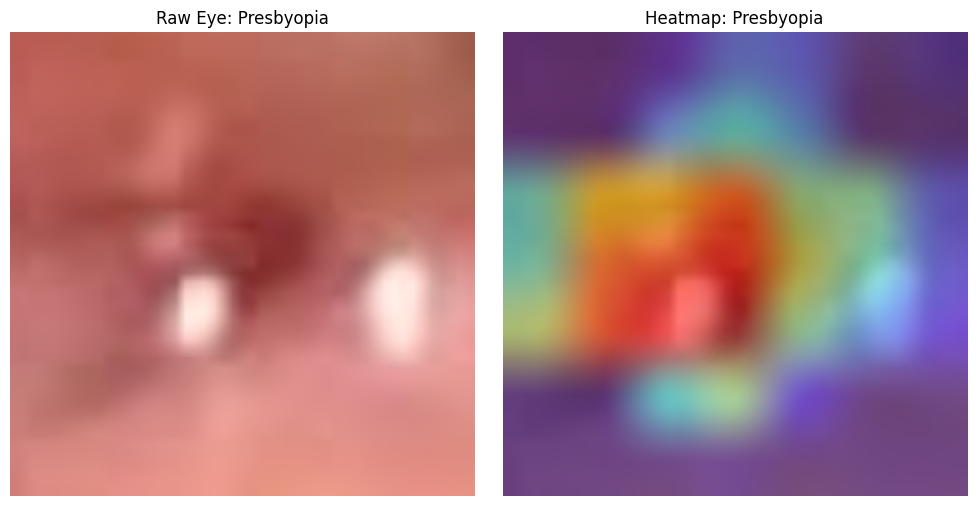

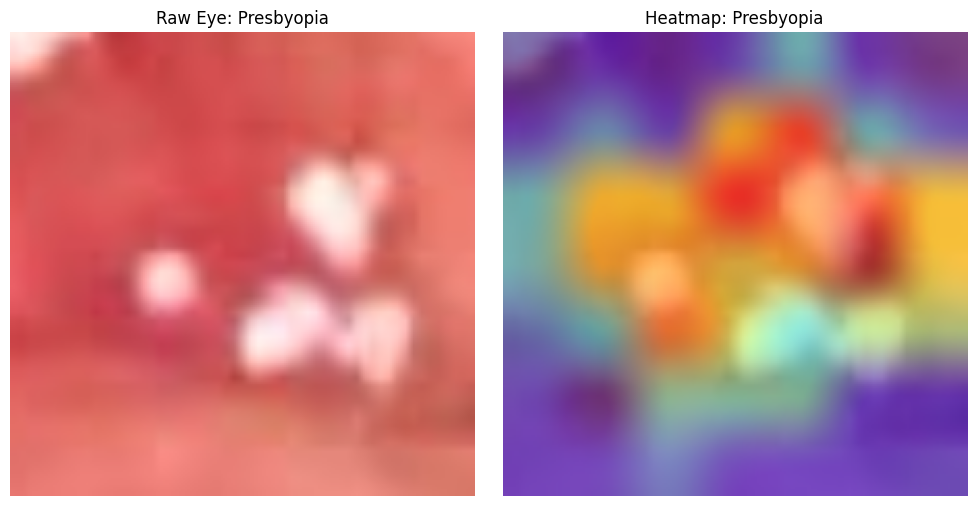

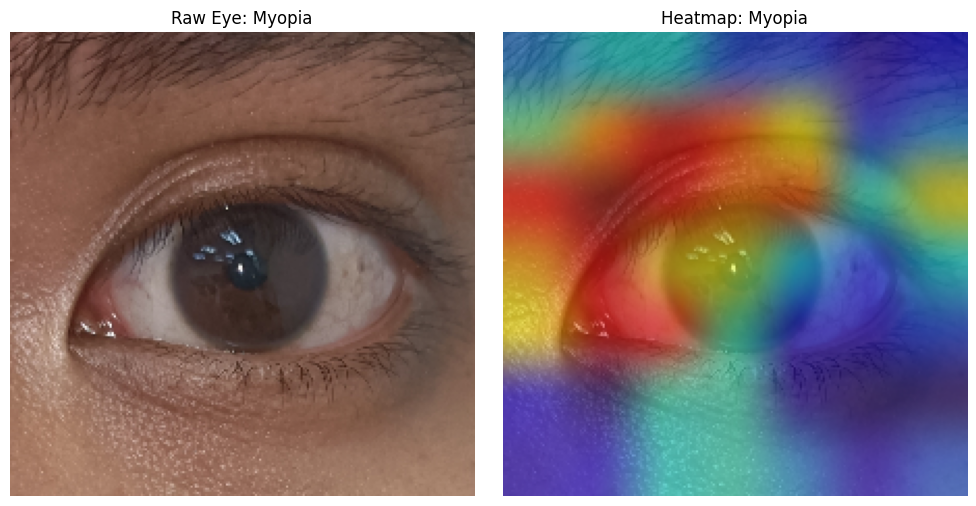

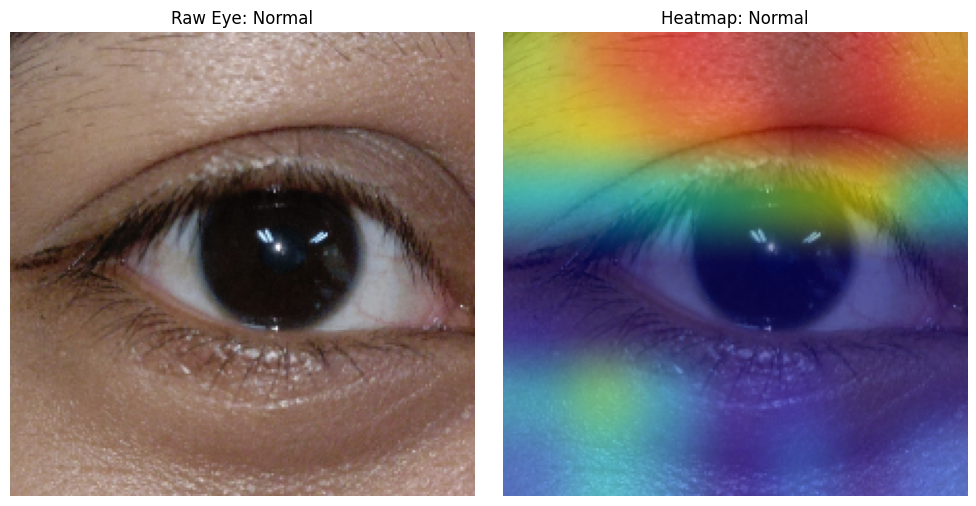

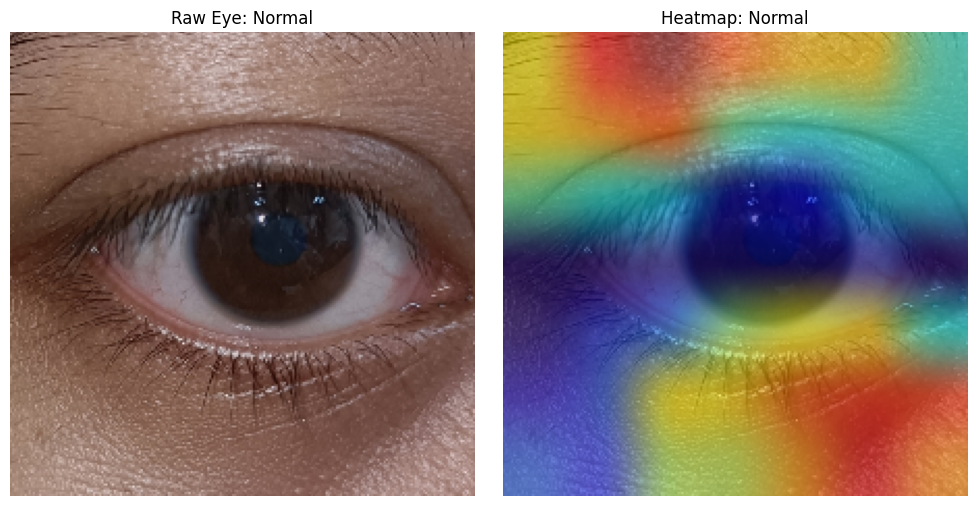

In [ ]:
import cv2
import os
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input

# Load a pretrained model (MobileNetV2)
model = MobileNetV2(weights="imagenet")
last_conv_layer_name = "Conv_1"

#def load_model():
		#base_model = smartAFNet
		#base_model.trainable = false
		#model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
		#return model

# Haar Cascade for eye detection
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')

# Function to detect and crop eye region
def detect_eyes(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    eyes = eye_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=10, minSize=(30, 30))

    cropped_eyes = []
    for (x, y, w, h) in eyes:
        cropped = img[y:y+h, x:x+w]
        cropped_eyes.append(cv2.resize(cropped, (224, 224)))
    return cropped_eyes

# Grad-CAM heatmap function
def get_grad_cam_heatmap(model, img_array, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# Overlay heatmap with multi-color gradient
def overlay_heatmap(image, heatmap, alpha=0.5):
    heatmap = cv2.applyColorMap(np.uint8(255 * heatmap), cv2.COLORMAP_JET)  # Apply "jet" colormap
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    heatmap = Image.fromarray(heatmap).resize(image.size, Image.BICUBIC)  # Resize to match image
    heatmap = np.array(heatmap)

    overlay = np.clip((1 - alpha) * np.array(image) + alpha * heatmap, 0, 255).astype("uint8")
    return Image.fromarray(overlay)

# Function to preprocess and display Grad-CAM
def process_and_display(image_path, label):
    eyes = detect_eyes(image_path)
    for eye in eyes[:2]:  # Limit to 2 eyes per image
        img_array = preprocess_input(np.expand_dims(eye, axis=0))  # Preprocess for model
        heatmap = get_grad_cam_heatmap(model, img_array, last_conv_layer_name)

        # Convert eye region to PIL image
        raw_eye_image = Image.fromarray(cv2.cvtColor(eye, cv2.COLOR_BGR2RGB))
        heatmapped_image = overlay_heatmap(raw_eye_image, heatmap)

        # Display raw and heatmapped images
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        axs[0].imshow(raw_eye_image)
        axs[0].set_title(f"Raw Eye: {label}")
        axs[0].axis("off")
        axs[1].imshow(heatmapped_image)
        axs[1].set_title(f"Heatmap: {label}")
        axs[1].axis("off")
        plt.tight_layout()
        plt.show()

# Directory containing datasets
base_dir = "/content/"
for label in os.listdir(base_dir):
    folder_path = os.path.join(base_dir, label)
    if not os.path.isdir(folder_path):
        continue

    # Iterate through the first 2 images in the folder
    images = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
    for img_path in images[:2]:
        process_and_display(img_path, label)


**Grad-CAM testing on random images for evaluation/validation**

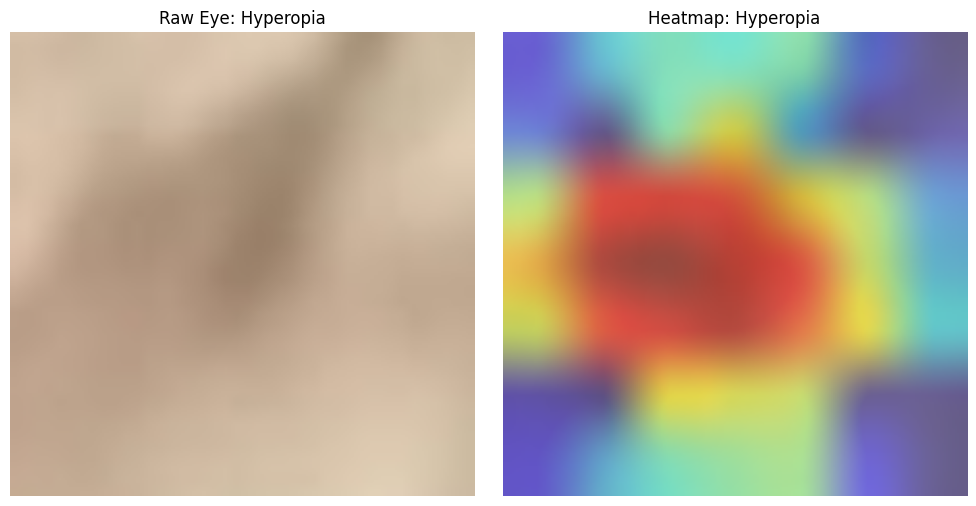

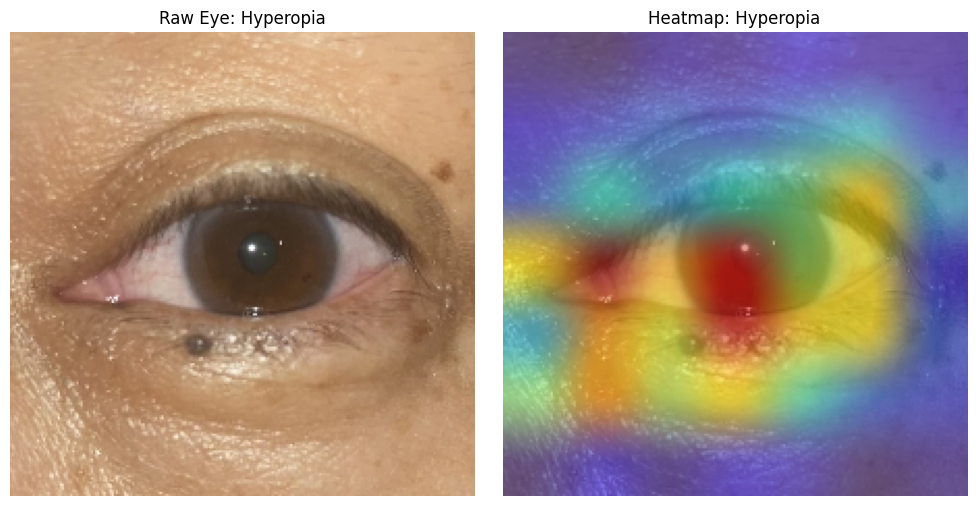

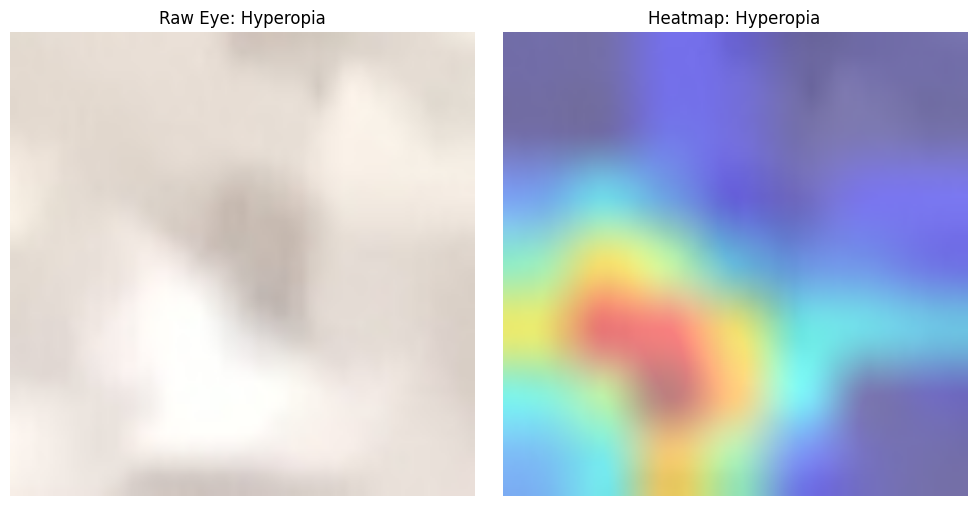

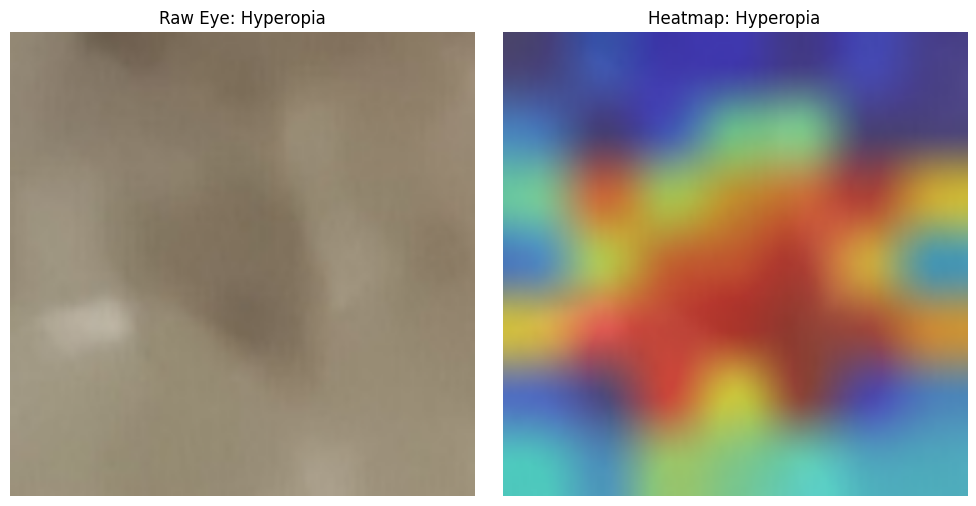

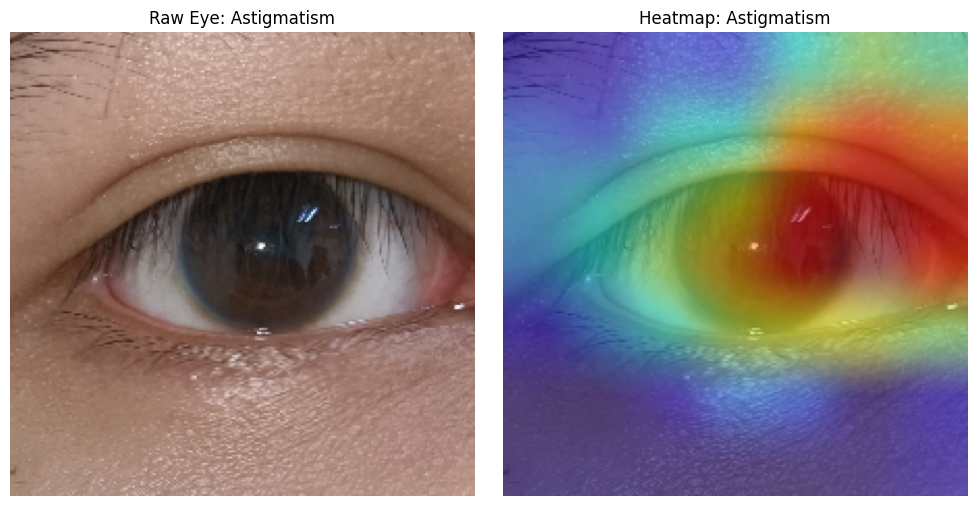

...

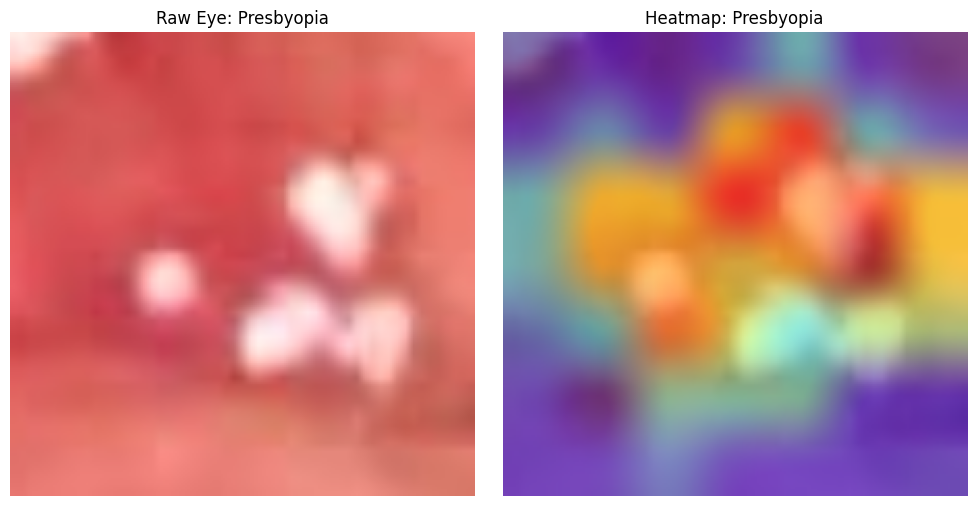

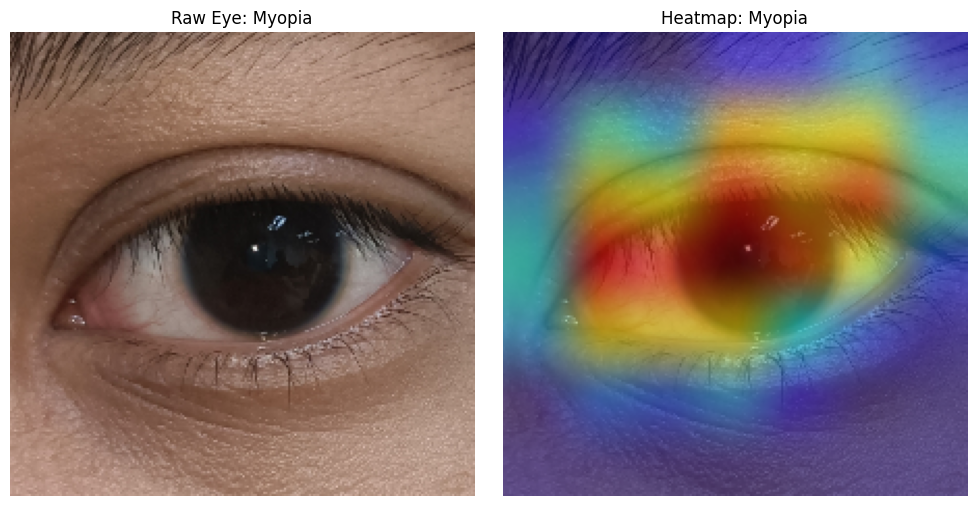

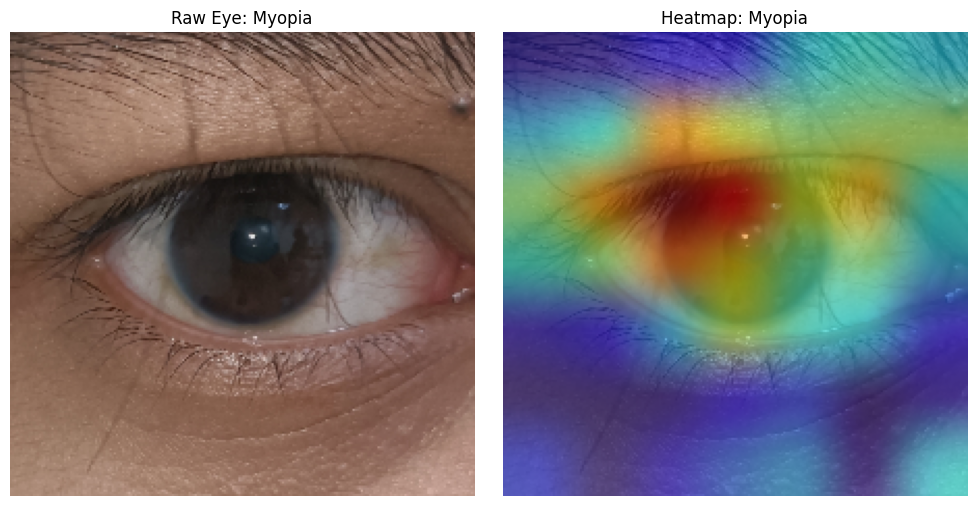

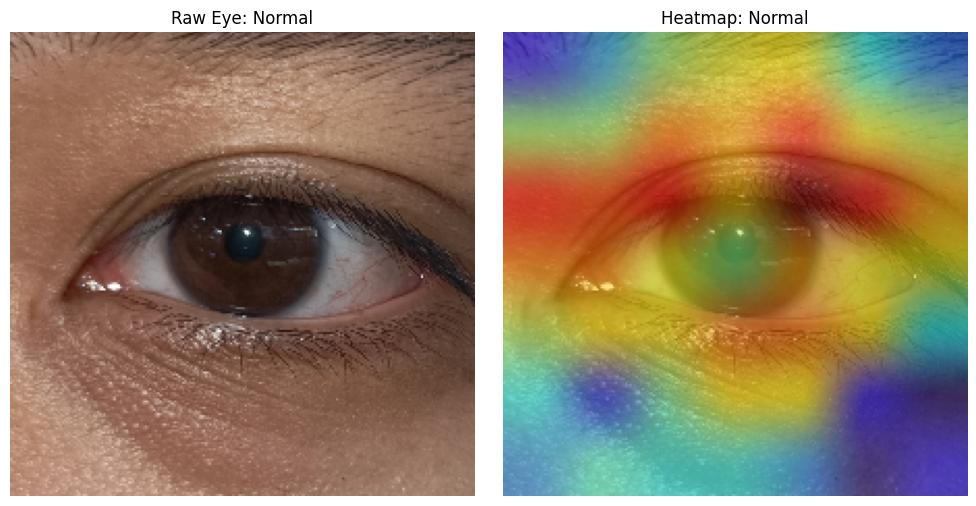

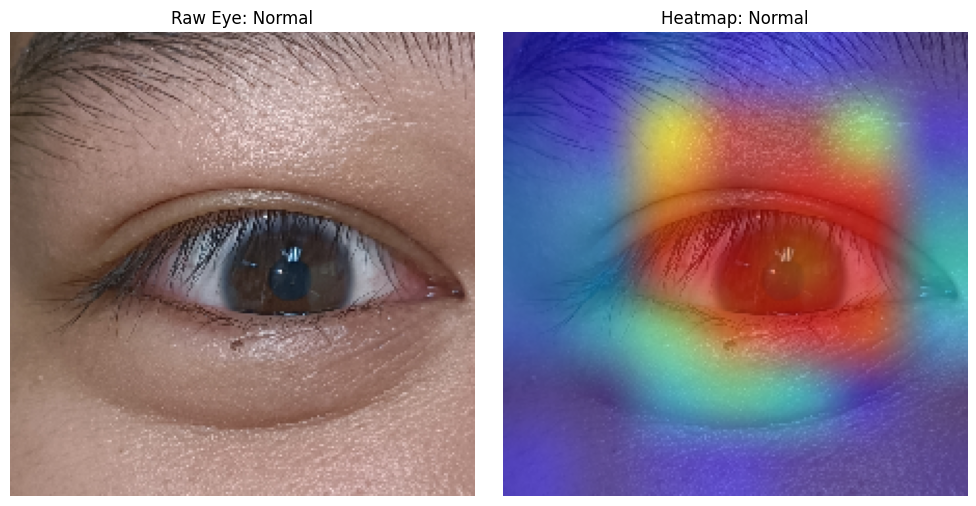

In [ ]:
import os
import random
import numpy as np
import matplotlib.pyplot as plt
from PIL import Image
import cv2
import tensorflow as tf
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input

# Load a pretrained model (MobileNetV2)
model = MobileNetV2(weights="imagenet")
last_conv_layer_name = "Conv_1"

#def load_model():
		#base_model = smartAFNet
		#base_model.trainable = false
		#model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
		#return model

# Haar Cascade for eye detection
eye_cascade = cv2.CascadeClassifier(cv2.data.haarcascades + 'haarcascade_eye.xml')

# Function to detect and crop eye region
def detect_eyes(image_path):
    img = cv2.imread(image_path)
    gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    eyes = eye_cascade.detectMultiScale(gray, scaleFactor=1.1, minNeighbors=10, minSize=(30, 30))

    cropped_eyes = []
    for (x, y, w, h) in eyes:
        cropped = img[y:y+h, x:x+w]
        cropped_eyes.append(cv2.resize(cropped, (224, 224)))
    return cropped_eyes

# Grad-CAM heatmap function
def get_grad_cam_heatmap(model, img_array, last_conv_layer_name, pred_index=None):
    grad_model = tf.keras.models.Model(
        [model.inputs], [model.get_layer(last_conv_layer_name).output, model.output]
    )
    with tf.GradientTape() as tape:
        conv_outputs, predictions = grad_model(img_array)
        if pred_index is None:
            pred_index = tf.argmax(predictions[0])
        class_channel = predictions[:, pred_index]

    grads = tape.gradient(class_channel, conv_outputs)
    pooled_grads = tf.reduce_mean(grads, axis=(0, 1, 2))
    conv_outputs = conv_outputs[0]
    heatmap = conv_outputs @ pooled_grads[..., tf.newaxis]
    heatmap = tf.squeeze(heatmap)
    heatmap = tf.maximum(heatmap, 0) / tf.math.reduce_max(heatmap)
    return heatmap.numpy()

# Overlay heatmap with multi-color gradient
def overlay_heatmap(image, heatmap, alpha=0.5):
    heatmap = cv2.applyColorMap(np.uint8(255 * heatmap), cv2.COLORMAP_JET)  # Apply "jet" colormap
    heatmap = cv2.cvtColor(heatmap, cv2.COLOR_BGR2RGB)  # Convert BGR to RGB
    heatmap = Image.fromarray(heatmap).resize(image.size, Image.BICUBIC)  # Resize to match image
    heatmap = np.array(heatmap)

    overlay = np.clip((1 - alpha) * np.array(image) + alpha * heatmap, 0, 255).astype("uint8")
    return Image.fromarray(overlay)

# Function to preprocess and display Grad-CAM
def process_and_display(image_path, label):
    eyes = detect_eyes(image_path)
    for eye in eyes[:2]:  # Limit to 2 eyes per image
        img_array = preprocess_input(np.expand_dims(eye, axis=0))  # Preprocess for model
        heatmap = get_grad_cam_heatmap(model, img_array, last_conv_layer_name)

        # Convert eye region to PIL image
        raw_eye_image = Image.fromarray(cv2.cvtColor(eye, cv2.COLOR_BGR2RGB))
        heatmapped_image = overlay_heatmap(raw_eye_image, heatmap)

        # Display raw and heatmapped images
        fig, axs = plt.subplots(1, 2, figsize=(10, 5))
        axs[0].imshow(raw_eye_image)
        axs[0].set_title(f"Raw Eye: {label}")
        axs[0].axis("off")
        axs[1].imshow(heatmapped_image)
        axs[1].set_title(f"Heatmap: {label}")
        axs[1].axis("off")
        plt.tight_layout()
        plt.show()

# Directory containing datasets
base_dir = "/content/"

for label in os.listdir(base_dir):
    folder_path = os.path.join(base_dir, label)
    if not os.path.isdir(folder_path):
        continue

    # Get all images in the folder and randomly select 2
    images = [os.path.join(folder_path, f) for f in os.listdir(folder_path) if f.endswith(('.png', '.jpg', '.jpeg'))]
    if len(images) >= 2:
        selected_images = random.sample(images, 2)  # Select 2 random images
    else:
        selected_images = images  # Use all images if less than 2 available

    # Process and display the selected images
    for img_path in selected_images:
        process_and_display(img_path, label)
